In [ ]:
# Basic Libraries
import os, sys, time
import string
import re

# Data Manipulation Libraries
import pandas as pd
import numpy as np
from collections import Counter, defaultdict 

# Visualization Libraries
import matplotlib.pyplot as plt
import seaborn as sns
import wordcloud
from wordcloud import WordCloud
from yellowbrick.cluster import SilhouetteVisualizer, KElbowVisualizer
%matplotlib inline

# Natural Language Processing Libraries
import nltk
from nltk.corpus import stopwords
from nltk import Counter
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.stem import WordNetLemmatizer, PorterStemmer, LancasterStemmer
from gensim.models import Word2Vec, Doc2Vec
from gensim.models.doc2vec import TaggedDocument
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from transformers import BertTokenizer, BertModel, TFBertModel

# Machine Learning and Deep Learning Libraries
import requests
import torch
import tensorflow_hub as hub
import tensorflow as tf
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import davies_bouldin_score, adjusted_rand_score, normalized_mutual_info_score, silhouette_score

# Miscellaneous Libraries
from tqdm import tqdm
from PIL import Image
import pandarallel
from pandarallel import pandarallel

# Initializations and Downloads
tqdm.pandas()
nltk.download('stopwords')
nltk.download("words")
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')


In [1740]:
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_row', 100)


In [1741]:
pandarallel.initialize(progress_bar=True, nb_workers=6)

INFO: Pandarallel will run on 6 workers.
INFO: Pandarallel will use standard multiprocessing data transfer (pipe) to transfer data between the main process and workers.


In [1742]:
data = pd.read_csv('./data/source/Flipkart/flipkart_com-ecommerce_sample_1050.csv', encoding="utf-8", parse_dates=[1], sep=',')
path_to_images = "./data/source/Flipkart/images/"

In [1743]:
image_files = os.listdir(path_to_images)
print(image_files[:20])


['aa68675f50a0551b8dadb954017a50a1.jpg', '037c2402fee39fbc80433935711d1383.jpg', '42643c1c9403f67921a18654bcf45ead.jpg', '53f4bc7d7321f5c41de6b86e41f13e80.jpg', 'b144a363c107c7bdd91f32d6e28ba6f2.jpg', 'db3e2eeb4fe90d4755f2911d661eae95.jpg', '9a9402ad55d079c86c302521816b7b0e.jpg', '42a8fef62716772c391fbdd148cc9c16.jpg', '503bb08f7bdf6a395ec564dd1dc83619.jpg', '42770faa04bfcf2b62e7ef335e1b1965.jpg', '9c4ab8ab059c912090c83cb0818e7f1c.jpg', 'f2fa99bfaa4aa65a2bd53337e140f949.jpg', 'a618354ba17cff64826558d81afc77ab.jpg', 'c063d07d78a55a21bf6c0e7c8ae46a6d.jpg', 'e99d9abb115a9bd580bcccf9ff4d4881.jpg', '1d829e0eac91d7e85cdd6d581c363360.jpg', '5c7b493625b5fc6689cae49d25e1ae17.jpg', '06749cbff1487f470438823f6952cfd1.jpg', 'ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg', '473b1ab1abe21826c41efa1584a88a63.jpg']


In [1744]:
print(f"Number of images in the folder: {len(image_files)}")

Number of images in the folder: 1050


In [1745]:
# Téléchargement d'une image
path_to_image = os.path.join(path_to_images, os.listdir(path_to_images)[38])  
#path_to_image= os.path.join(path_to_images, "f8aa59c4a170e8a90ae832b173b2b2d9.jpg")
img = Image.open(path_to_image)

# Obtenir des informations sur l'image
format_img = img.format  # Format d'image
size_img = img.size  # Dimensions de l'image
file_size = os.path.getsize(path_to_image)  # Taille du fichier

print(f"Format d'image: {format_img}")
print(f"Dimensions de l'image: {size_img}")
print(f"Taille du fichier: {file_size} байтів")



Format d'image: JPEG
Dimensions de l'image: (2477, 1246)
Taille du fichier: 586241 байтів


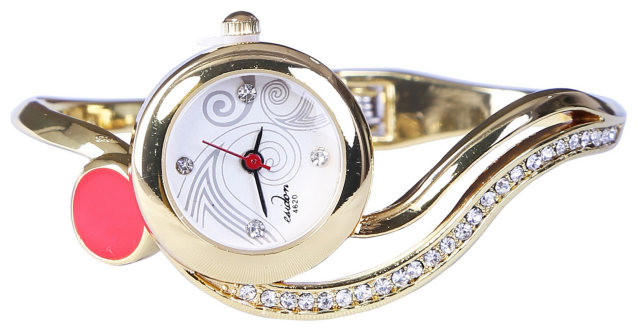

In [1746]:
plt.imshow(img)
plt.axis('off')  ### désactiver l'affichage des axes de coordonnées
plt.show()

In [1747]:
data.sample(6)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
764,e24ef34ede03630207f0d367f633d8ea,2015-12-12 11:46:53+00:00,http://www.flipkart.com/chappin-nellson-cnl-50...,Chappin & Nellson CNL-50-White-RG Analog Watch...,"[""Watches >> Wrist Watches >> Chappin & Nellso...",WATDW8E5PGWQUFWY,1999.0,799.0,e24ef34ede03630207f0d367f633d8ea.jpg,False,Chappin & Nellson CNL-50-White-RG Analog Watch...,3.7,3.7,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va..."
744,73523a8cc9a5c04a010d0307f2f2827a,2015-12-12 11:46:53+00:00,http://www.flipkart.com/nutcase-sticker-wrap-d...,Nutcase Sticker Wrap Design - Gummy Bears 800 ...,"[""Kitchen & Dining >> Containers & Bottles >> ...",BOTEANCHFY7TGFKX,799.0,399.0,73523a8cc9a5c04a010d0307f2f2827a.jpg,False,Nutcase Sticker Wrap Design - Gummy Bears 800 ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Body Mater..."
787,7264f56639c8c54158b94ced769082c8,2015-12-12 11:46:53+00:00,http://www.flipkart.com/perucci-pc-218-decker-...,Perucci PC-218 Decker Analog Watch - For Men,"[""Watches >> Wrist Watches >> Perucci Wrist Wa...",WATE75EHQFGUKVZQ,1600.0,1290.0,7264f56639c8c54158b94ced769082c8.jpg,False,Perucci PC-218 Decker Analog Watch - For Men ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."
666,f9a8320c182841024f47ebcba284085a,2015-12-31 09:19:31+00:00,http://www.flipkart.com/portia-polka-print-tre...,Portia Polka Print Trendy Cap,"[""Baby Care >> Infant Wear >> Baby Girls' Clot...",CAPEDKXZJYCYQANZ,900.0,399.0,f9a8320c182841024f47ebcba284085a.jpg,False,Portia Polka Print Trendy Cap - Buy Multicolor...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Pattern"", ..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52+00:00,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."
328,7c4c57dda1b2e50f40b331cc8f9d233b,2015-12-01 06:13:00+00:00,http://www.flipkart.com/adidas-dynamic-pulse-t...,Adidas Dynamic Pulse and Team Force Combo Set,"[""Beauty and Personal Care >> Fragrances >> De...",CAGE6HYJW7VBXDMZ,398.0,295.0,7c4c57dda1b2e50f40b331cc8f9d233b.jpg,False,Flipkart.com: Buy Adidas Dynamic Pulse and Tea...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Number of ..."


In [1748]:
data.shape

(1050, 15)

In [1749]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype              
---  ------                   --------------  -----              
 0   uniq_id                  1050 non-null   object             
 1   crawl_timestamp          1050 non-null   datetime64[ns, UTC]
 2   product_url              1050 non-null   object             
 3   product_name             1050 non-null   object             
 4   product_category_tree    1050 non-null   object             
 5   pid                      1050 non-null   object             
 6   retail_price             1049 non-null   float64            
 7   discounted_price         1049 non-null   float64            
 8   image                    1050 non-null   object             
 9   is_FK_Advantage_product  1050 non-null   bool               
 10  description              1050 non-null   object             
 11  product_rating           1050 

In [1750]:
data.isna().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [1751]:
data.nunique()


uniq_id                    1050
crawl_timestamp             149
product_url                1050
product_name               1050
product_category_tree       642
pid                        1050
retail_price                354
discounted_price            424
image                      1050
is_FK_Advantage_product       2
description                1050
product_rating               27
overall_rating               27
brand                       490
product_specifications      984
dtype: int64

<AxesSubplot:>

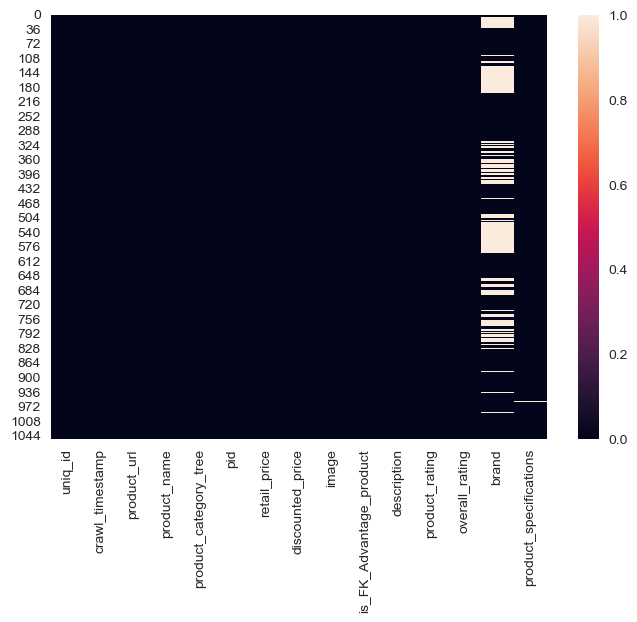

In [1752]:
sns.heatmap(data.isna())

In [1753]:
# Les valeurs manquantes pour la variable "brand" sont remplacés par "".
data["brand"].fillna("", inplace=True)

In [1754]:
data.isna().sum()

uniq_id                    0
crawl_timestamp            0
product_url                0
product_name               0
product_category_tree      0
pid                        0
retail_price               1
discounted_price           1
image                      0
is_FK_Advantage_product    0
description                0
product_rating             0
overall_rating             0
brand                      0
product_specifications     1
dtype: int64

In [1755]:
data[data['retail_price'].isna()]


,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56+00:00,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."


In [1756]:
data[data['product_specifications'].isna()]

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
957,e488005c7fb68747d3458c7d73760bae,2016-02-24 04:24:17+00:00,http://www.flipkart.com/nutcase-multicolor-col...,Nutcase Multicolor Column Floor Lamp,"[""Home Decor & Festive Needs >> Decorative Lig...",FIOEFUXPJQYZKDXZ,3299.0,1299.0,e488005c7fb68747d3458c7d73760bae.jpg,False,Key Features of Nutcase Multicolor Column Floo...,No rating available,No rating available,Nutcase,NaN


In [1757]:
data['product_category_tree']

0       ["Home Furnishing >> Curtains & Accessories >>...
1       ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
2       ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
3       ["Home Furnishing >> Bed Linen >> Bedsheets >>...
4       ["Home Furnishing >> Bed Linen >> Bedsheets >>...
                              ...                        
1045    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1046    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1047    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1048    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1049    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
Name: product_category_tree, Length: 1050, dtype: object

In [1758]:
def extract_category(product_category_tree, level):
    categories = product_category_tree.split('>>')
    
    # Pour la catégorie principale
    if level == 0:
        return categories[0][2:].strip()  # supprimer les caractères supplémentaires au début

    # Pour les sous-catégories
    elif 0 < level < len(categories):
        return categories[level].strip()
    
    else:
        return None

data['main_category'] = data['product_category_tree'].apply(lambda x: extract_category(x, 0))
data['sub_category1'] = data['product_category_tree'].apply(lambda x: extract_category(x, 1))
data['sub_category2'] = data['product_category_tree'].apply(lambda x: extract_category(x, 2))


In [1759]:
print(f"There are {data.main_category.unique().shape[0]} categories of first level.")

There are 7 categories of first level.


In [1760]:
data.sub_category2.unique().shape[0]

247

In [1761]:
data.sub_category1.unique().shape[0]

63

In [1762]:
data.sub_category2.unique()

array(['Curtains', 'Baby Bath Towels', 'Bedsheets',
       'Maserati Time Wrist Watches"]', 'Camerii Wrist Watches"]',
       'T STAR Wrist Watches"]', 'Alfajr Wrist Watches"]',
       'TAG Heuer Wrist Watches"]', 'Calibro Wrist Watches"]',
       'Cartier Wrist Watches"]', 'Lois Caron Wrist Watches"]',
       'Titan Wrist Watches"]', 'Srushti Art Jewelry Wrist Watches"]',
       'Escort Wrist Watches"]', 'Jack klein Wrist Watches"]',
       'North Moon Wrist Watches"]', 'Franck Bella Wrist Watches"]',
       'Ridas Wrist Watches"]', 'Skmei Wrist Watches"]',
       'Now Wrist Watches"]', 'fastrack Wrist Watches"]',
       'Disney Wrist Watches"]', 'Vizion Wrist Watches"]',
       'Elantra Wrist Watches"]', 'Marvel Wrist Watches"]',
       'Lenco Wrist Watches"]', 'D\'Signer Wrist Watches"]', 'Diwan Sets',
       'Duvet Covers', 'Bath Mats"]', 'Home Fragrances',
       'Jug, Glass & Tray Sets', 'Bulbs',
       'JMD Printed Cushions Cover (Pack of 2, 40 cm*40 ..."]',
       "Baby Girls' 

In [1763]:
data['sub_category2'] = data['sub_category2'].str.replace('"]', '')

In [1764]:
print(f"There are {data.sub_category2.unique().shape[0]} categories of third level.")

There are 242 categories of third level.


In [1765]:
data.sub_category1.unique()

array(['Curtains & Accessories', 'Baby Bath & Skin', 'Bed Linen',
       'Wrist Watches', 'Living Room Furnishing', 'Bath Linen',
       'Candles & Fragrances', 'Tableware & Cutlery', 'Lighting',
       'JMD Home Furnishing', 'Infant Wear', "Kripa's Home Furnishing",
       'Hair Care', 'Coffee Mugs', 'Network Components',
       'Tablet Accessories', 'Cookware', 'Laptop Accessories', 'Makeup',
       'Combos and Kits', 'Feeding & Nursing', 'Baby Bedding',
       'Kitchen & Dining Linen', 'Containers & Bottles',
       'Consumables & Disposables', 'Wall Decor & Clocks',
       'Table Decor & Handicrafts', 'Flowers, Plants & Vases', 'Software',
       'Showpieces', 'Furniture & Furnishings',
       'Decorative Lighting & Lamps', 'Baby Grooming',
       'Computer Peripherals', 'Cushions, Pillows & Covers', 'Storage',
       'Health Care', 'Body and Skin Care', 'Kitchen Tools',
       'TRUE Home Decor & Festive Needs"]', 'Living', 'Showpiece',
       'Bar & Glassware', 'Fragrances', "Wome

In [1766]:
data['sub_category1'] = data['sub_category1'].str.replace('"]', '')

In [1767]:
print(f"There are {data.sub_category1.unique().shape[0]} categories of second level.")

There are 62 categories of second level.


In [1768]:
data.main_category.unique()

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [1769]:
categores = data.main_category.unique().tolist()
categores

['Home Furnishing',
 'Baby Care',
 'Watches',
 'Home Decor & Festive Needs',
 'Kitchen & Dining',
 'Beauty and Personal Care',
 'Computers']

In [1770]:
data.isna().sum()

uniq_id                    0
crawl_timestamp            0
product_url                0
product_name               0
product_category_tree      0
pid                        0
retail_price               1
discounted_price           1
image                      0
is_FK_Advantage_product    0
description                0
product_rating             0
overall_rating             0
brand                      0
product_specifications     1
main_category              0
sub_category1              0
sub_category2              3
dtype: int64

In [1771]:
print(data[data['sub_category2'].isna()==True])

                              uniq_id           crawl_timestamp   
250  17611e6e94d73ef376834e5c6ee03dde 2015-12-01 12:40:44+00:00  \
873  159b45e4dede207f28319bf1cacee3bc 2015-12-20 08:26:17+00:00   
875  e56ffc10078972b5f4e7302383db8d72 2015-12-20 08:26:17+00:00   

                                           product_url   
250  http://www.flipkart.com/true-bong/p/itmeb467du...  \
873  http://www.flipkart.com/msenterprises-floral-c...   
875  http://www.flipkart.com/nikunj-abstract-cushio...   

                            product_name   
250                            TRUE Bong  \
873  MSenterprises Floral Cushions Cover   
875       Nikunj Abstract Cushions Cover   

                                 product_category_tree               pid   
250  ["Home Decor & Festive Needs >> TRUE Home Deco...  BNGEB467ZXZZ4HWS  \
873                      ["Home Furnishing >> Living"]  CPCEDGM4RPXJHBHG   
875                      ["Home Furnishing >> Living"]  CPCECSABG58X5KHG   

     retail_pric

In [1772]:
for value in data['sub_category1'].unique():
    mode_values = data[data['sub_category1'] == value]['sub_category2'].mode()
    if mode_values.empty:
        print(f"No mode found for sub_category1 value: {value}")


No mode found for sub_category1 value: TRUE Home Decor & Festive Needs


In [1773]:
data[data['sub_category1']=='TRUE Home Decor & Festive Needs']

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,main_category,sub_category1,sub_category2
250,17611e6e94d73ef376834e5c6ee03dde,2015-12-01 12:40:44+00:00,http://www.flipkart.com/true-bong/p/itmeb467du...,TRUE Bong,"[""Home Decor & Festive Needs >> TRUE Home Deco...",BNGEB467ZXZZ4HWS,999.0,549.0,17611e6e94d73ef376834e5c6ee03dde.jpg,False,Buy TRUE Bong for Rs.549 online. TRUE Bong at ...,No rating available,No rating available,TRUE,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,TRUE Home Decor & Festive Needs,None


In [1774]:
# Nous remplaçons la valeur NaN par 'decor'
data.loc[(data['sub_category1'] == 'TRUE Home Decor & Festive Needs') & (data['sub_category2'].isna()), 'sub_category2'] = 'decor'


In [1775]:
# Trouver la valeur modale de sub_category2 pour les lignes où sub_category1 a une valeur "Living"
mode_value = data[data['sub_category1'] == 'Living']['sub_category2'].mode().iloc[0]

# Nous remplaçons la valeur NaN par la valeur modale trouvée
data.loc[(data['sub_category1'] == 'Living') & (data['sub_category2'].isna()), 'sub_category2'] = mode_value


In [1776]:
data.isna().sum()

uniq_id                    0
crawl_timestamp            0
product_url                0
product_name               0
product_category_tree      0
pid                        0
retail_price               1
discounted_price           1
image                      0
is_FK_Advantage_product    0
description                0
product_rating             0
overall_rating             0
brand                      0
product_specifications     1
main_category              0
sub_category1              0
sub_category2              0
dtype: int64

In [1777]:
data.groupby("main_category").count()["uniq_id"]

main_category
Baby Care                     150
Beauty and Personal Care      150
Computers                     150
Home Decor & Festive Needs    150
Home Furnishing               150
Kitchen & Dining              150
Watches                       150
Name: uniq_id, dtype: int64

Cela peut être dû à la manière dont les données sont collectées. Par exemple, si on as utilisé le web scraping, il est possible qu'ils aient fixé une limite maximale de 150 entrées par catégorie.

In [1778]:
data['sub_category1'].value_counts()


sub_category1
Wrist Watches                      149
Laptop Accessories                  87
Infant Wear                         84
Coffee Mugs                         74
Showpieces                          71
Bed Linen                           65
Fragrances                          65
Network Components                  49
Cookware                            27
Table Decor & Handicrafts           27
Combos and Kits                     24
Wall Decor & Clocks                 22
Bath Linen                          21
Curtains & Accessories              19
Makeup                              18
Baby Bedding                        15
Body and Skin Care                  15
Baby & Kids Gifts                   15
Baby Bath & Skin                    14
Kitchen Tools                       14
Kitchen & Dining Linen              14
Decorative Lighting & Lamps         14
Containers & Bottles                13
Cushions, Pillows & Covers          13
Hair Care                            9
Feeding & N

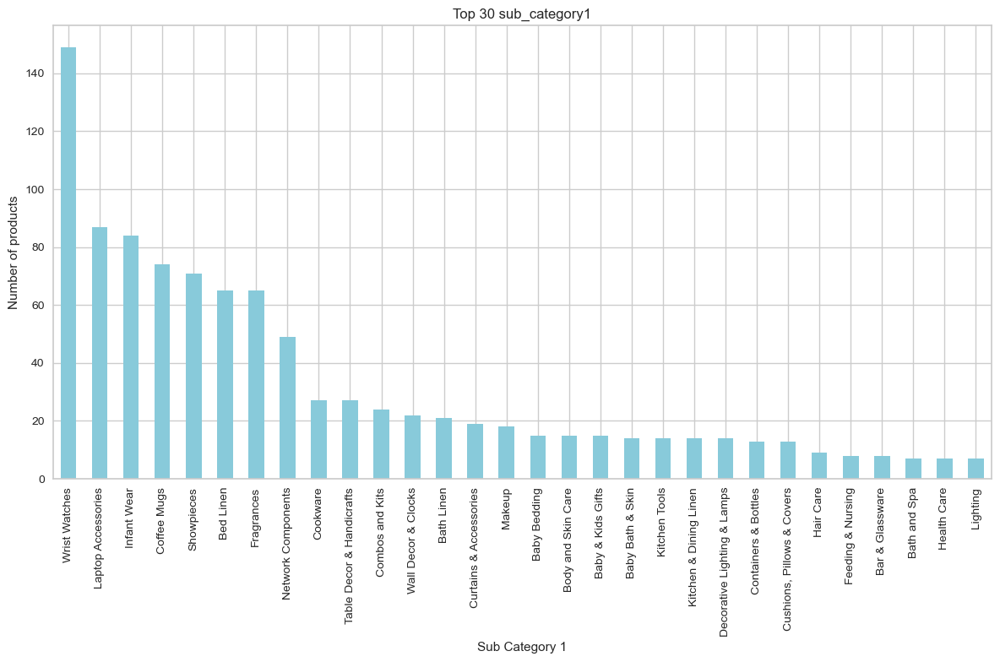

In [1779]:
# Graphique pour sub_category1
sub_cat1_counts = sub_cat1_counts.head(30)
plt.figure(figsize=(12,8))
sub_cat1_counts.plot(kind='bar', color='c')
plt.title('Top 30 sub_category1')
plt.ylabel('Number of products')
plt.xlabel('Sub Category 1')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

Il y a 62 catégories différentes pour la profondeur 2 et la répartition des products dans les catégories est très inégale.

In [1780]:
data.groupby("sub_category2").count()["uniq_id"]

sub_category2
AKUP Coffee Mugs              5
AM Creation Coffee Mugs       1
Aapno Rajasthan Showpieces    2
Adaa Showpieces               1
Adapters                      9
                             ..
decor                         1
eCraftIndia Showpieces        1
fastrack Wrist Watches        1
palito Wrist Watches          3
posterchacha Coffee Mugs      1
Name: uniq_id, Length: 242, dtype: int64

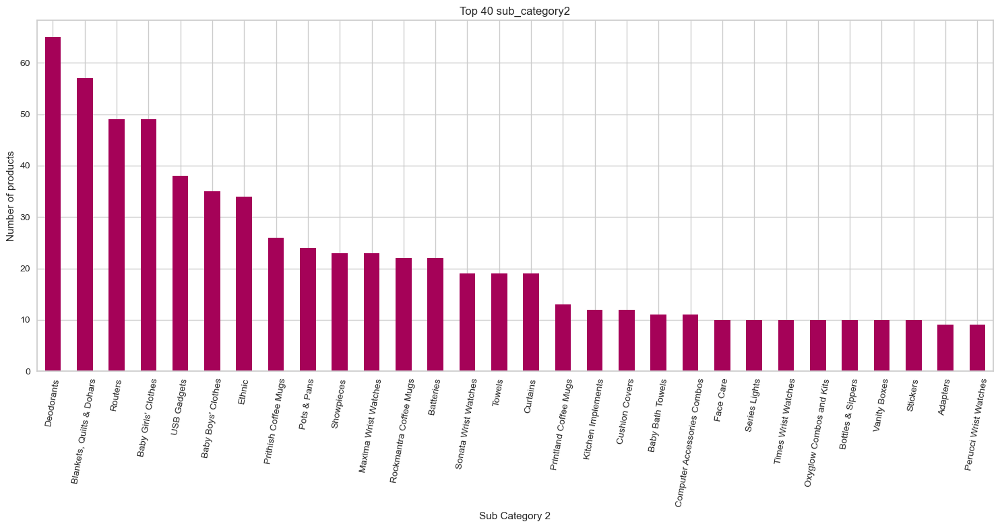

In [1781]:
# Graphique pour sub_category2
sub_cat2_counts = data['sub_category2'].value_counts().head(30)

plt.figure(figsize=(15,8))
sub_cat2_counts.plot(kind='bar', color='m')
plt.title('Top 40 sub_category2')
plt.ylabel('Number of products')
plt.xlabel('Sub Category 2')
plt.xticks(rotation=80)
plt.tight_layout()
plt.show()

Il y a 242 catégories différentes pour la profondeur 3 et la répartition des products dans les catégories est très inégale.

# Les catégories utilisés pour la résolution du problème de segmentation: main_category

In [1782]:
data.describe(include=object)

,uniq_id,product_url,product_name,product_category_tree,pid,image,description,product_rating,overall_rating,brand,product_specifications,main_category,sub_category1,sub_category2
count,1050,1050,1050,1050,1050,1050,1050,1050,1050,1050,1049,1050,1050,1050
unique,1050,1050,1050,642,1050,1050,1050,27,27,491,984,7,62,242
top,55b85ea15a1536d46b7190ad6fff8ce7,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",CRNEG7BKMFFYHQ8Z,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,,"{""product_specification""=>[{""key""=>""Type"", ""va...",Home Furnishing,Wrist Watches,Deodorants
freq,1,1,1,56,1,1,1,889,889,338,22,150,149,65


In [1783]:
data.describe(include=np.number)

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


In [1784]:
data['product_specifications']

0       {"product_specification"=>[{"key"=>"Brand", "v...
1       {"product_specification"=>[{"key"=>"Machine Wa...
2       {"product_specification"=>[{"key"=>"Material",...
3       {"product_specification"=>[{"key"=>"Brand", "v...
4       {"product_specification"=>[{"key"=>"Machine Wa...
                              ...                        
1045    {"product_specification"=>[{"key"=>"Number of ...
1046    {"product_specification"=>[{"key"=>"Number of ...
1047    {"product_specification"=>[{"key"=>"Number of ...
1048    {"product_specification"=>[{"key"=>"Number of ...
1049    {"product_specification"=>[{"key"=>"Sales Pack...
Name: product_specifications, Length: 1050, dtype: object

In [1785]:
# Exemples de product_specifications
data.loc[2, "product_specifications"]

'{"product_specification"=>[{"key"=>"Material", "value"=>"Cotton Terry"}, {"key"=>"Design", "value"=>"SHUVAM"}, {"key"=>"Brand", "value"=>"Eurospa"}, {"key"=>"GSM", "value"=>"360"}, {"key"=>"Type", "value"=>"Face Towel Set"}, {"key"=>"Model Name", "value"=>"SHUVAM20PCFTSETASSORTED"}, {"key"=>"Ideal For", "value"=>"Boys, Girls, Men, Women"}, {"key"=>"Model ID", "value"=>"SHUVAM20PCFTSETASSORTED"}, {"key"=>"Size", "value"=>"small"}, {"key"=>"Color", "value"=>"Assorted"}, {"key"=>"Weight", "value"=>"350 g"}, {"key"=>"Length", "value"=>"9 inch"}, {"key"=>"Width", "value"=>"9 inch"}, {"key"=>"Number of Contents in Sales Package", "value"=>"20"}, {"key"=>"Sales Package", "value"=>"20 PIECE FACE TOWEL SET"}]}'

In [1786]:
# Exemples de description
data.loc[6, "description"]

'Camerii WM64 Elegance Analog Watch  - For Men, Boys - Buy Camerii WM64 Elegance Analog Watch  - For Men, Boys  WM64 Online at Rs.449 in India Only at Flipkart.com. - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!'

In [1787]:
data.description.apply(lambda i: len(i)).sort_values()

877      109
890      109
1030     111
651      112
892      112
        ... 
589     2436
916     2529
715     2594
639     3447
437     3490
Name: description, Length: 1050, dtype: int64

<AxesSubplot:>

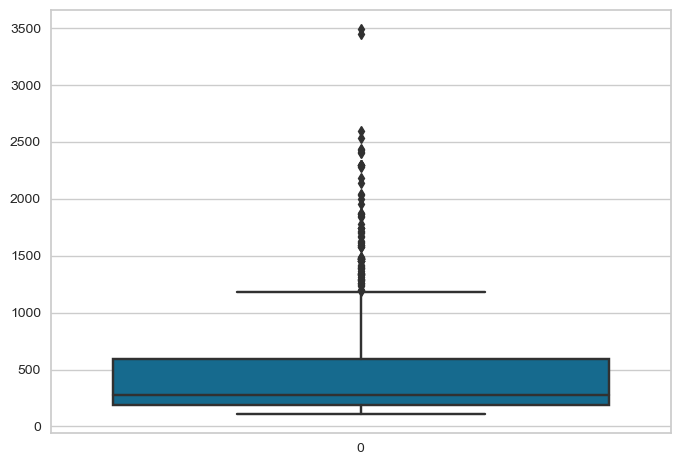

In [1788]:
tmp=data.description.str.len()
sns.boxplot(tmp)

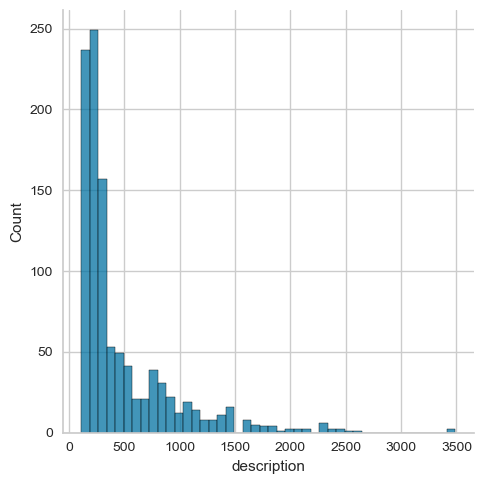

In [1789]:
sns.displot(tmp)

In [1790]:
# Exemples de product_name
data.loc[6, "product_name"]

'Camerii WM64 Elegance Analog Watch  - For Men, Boys'

In [1791]:
data.product_name.apply(lambda i: len(i)).sort_values()

355      8
335      8
250      9
909     10
364     11
      ... 
833    109
848    112
851    115
855    149
242    151
Name: product_name, Length: 1050, dtype: int64

<AxesSubplot:>

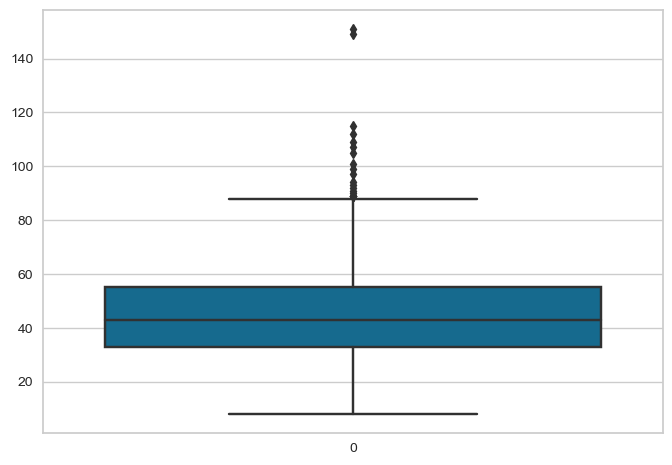

In [1792]:
tmp1=data.product_name.str.len()
sns.boxplot(tmp1)

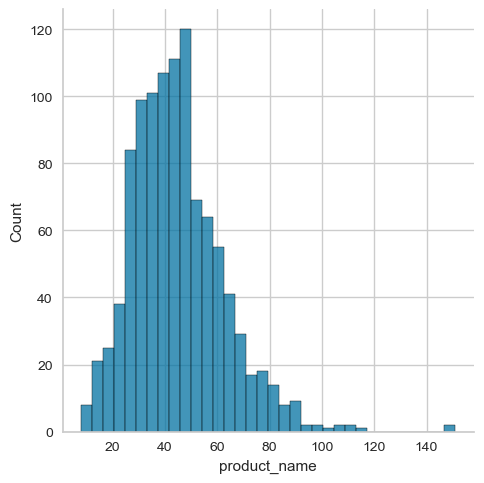

In [1793]:
sns.displot(tmp1)

In [1794]:
# Exemples de brand
data.loc[1004, "brand"]

'Doraemon Gift Family Ceramic Coffee Mug'

In [1795]:
data.brand.apply(lambda i: len(i)).sort_values()

524      0
495      0
496      0
497      0
498      0
        ..
793     24
734     25
282     25
661     35
1004    39
Name: brand, Length: 1050, dtype: int64

<AxesSubplot:>

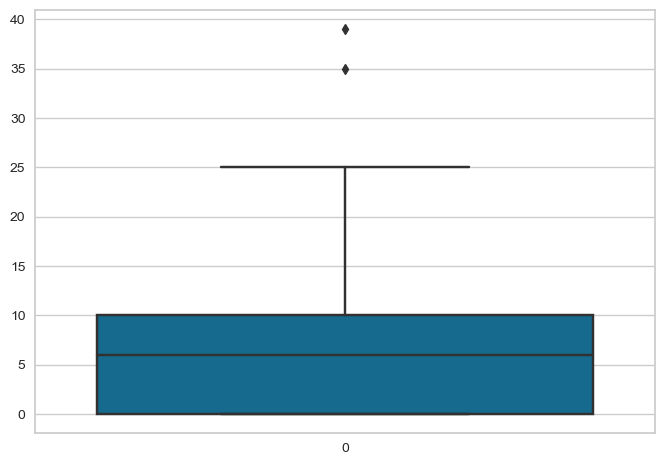

In [1796]:
tmp2=data.brand.str.len()
sns.boxplot(tmp2)

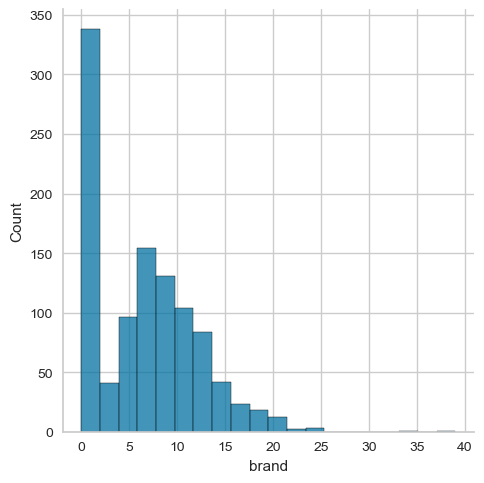

In [1797]:
sns.displot(tmp2)

In [1798]:
data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,main_category,sub_category1,sub_category2
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56+00:00,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Curtains & Accessories,Curtains
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56+00:00,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",Baby Care,Baby Bath & Skin,Baby Bath Towels
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56+00:00,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",Baby Care,Baby Bath & Skin,Baby Bath Towels
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52+00:00,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Bed Linen,Bedsheets
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52+00:00,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing,Bed Linen,Bedsheets


In [1799]:
corr = data.apply(lambda x: pd.factorize(x)[0]).corr()
corr

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,main_category,sub_category1,sub_category2
uniq_id,1.000000,0.979556,1.000000,1.000000,0.874808,1.000000,0.313707,0.440964,1.000000,-0.009243,1.000000,0.020115,0.020115,0.729475,0.991097,-0.197900,0.044703,0.460524
crawl_timestamp,0.979556,1.000000,0.979556,0.979556,0.866566,0.979556,0.280646,0.415277,0.979556,-0.056631,0.979556,-0.019874,-0.019874,0.746575,0.972962,-0.199442,0.065582,0.458360
product_url,1.000000,0.979556,1.000000,1.000000,0.874808,1.000000,0.313707,0.440964,1.000000,-0.009243,1.000000,0.020115,0.020115,0.729475,0.991097,-0.197900,0.044703,0.460524
product_name,1.000000,0.979556,1.000000,1.000000,0.874808,1.000000,0.313707,0.440964,1.000000,-0.009243,1.000000,0.020115,0.020115,0.729475,0.991097,-0.197900,0.044703,0.460524
product_category_tree,0.874808,0.866566,0.874808,0.874808,1.000000,0.874808,0.262927,0.379652,0.874808,0.010355,0.874808,0.039378,0.039378,0.617769,0.864820,-0.016333,0.183271,0.521762
pid,1.000000,0.979556,1.000000,1.000000,0.874808,1.000000,0.313707,0.440964,1.000000,-0.009243,1.000000,0.020115,0.020115,0.729475,0.991097,-0.197900,0.044703,0.460524
retail_price,0.313707,0.280646,0.313707,0.313707,0.262927,0.313707,1.000000,0.484530,0.313707,0.057399,0.313707,0.077256,0.077256,0.098752,0.304645,0.006685,0.104451,0.216792
discounted_price,0.440964,0.415277,0.440964,0.440964,0.379652,0.440964,0.484530,1.000000,0.440964,0.016751,0.440964,0.034549,0.034549,0.259278,0.434273,0.009676,0.071438,0.300730
image,1.000000,0.979556,1.000000,1.000000,0.874808,1.000000,0.313707,0.440964,1.000000,-0.009243,1.000000,0.020115,0.020115,0.729475,0.991097,-0.197900,0.044703,0.460524
is_FK_Advantage_product,-0.009243,-0.056631,-0.009243,-0.009243,0.010355,-0.009243,0.057399,0.016751,-0.009243,1.000000,-0.009243,0.350498,0.350498,-0.148407,-0.012434,-0.010508,-0.147907,0.077620


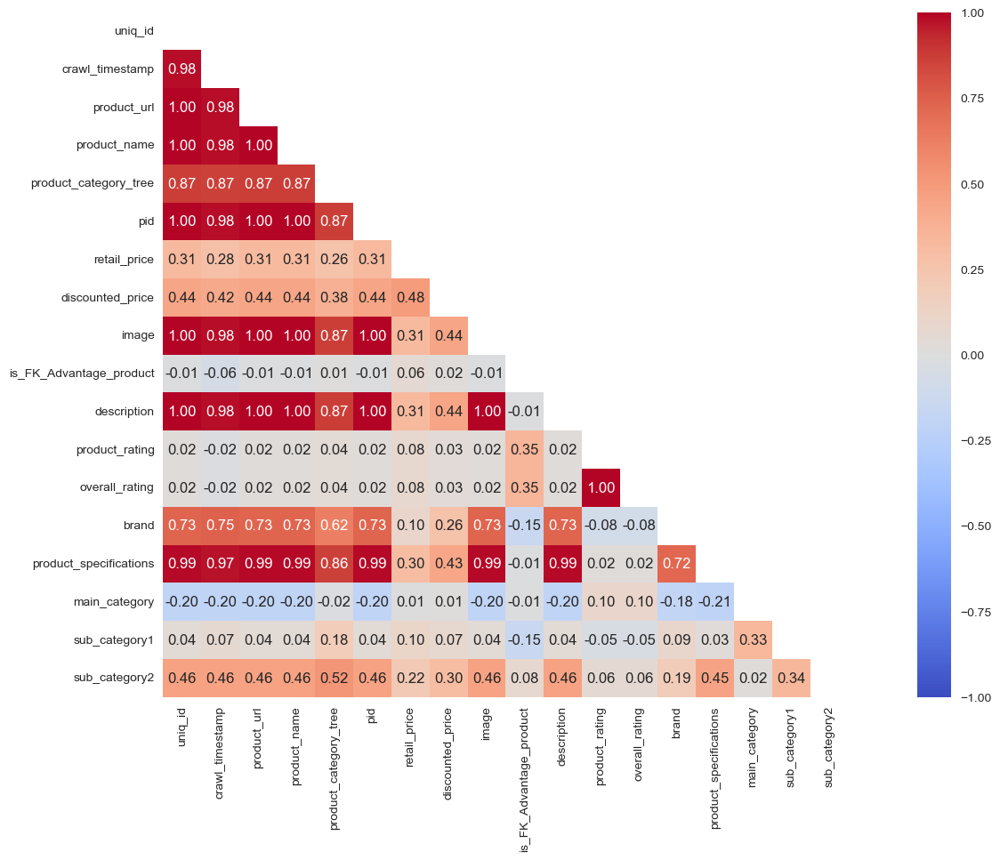

In [1800]:
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

fig, ax = plt.subplots(1, 1, figsize=(20, 10))
ax = sns.heatmap(corr, mask=mask, vmin=-1, vmax=1, cmap='coolwarm', annot=True, fmt=".2f", square=True)

In [1801]:
# Définisez les stopwords à supprimer
stopwords = nltk.corpus.stopwords.words('english')
# Ajouter plus de mots non informatifs
uninformative_words = ["price", "cash", "delivery", "pack", "flipkart", "buy", "sale", "product", "feature",
                       "print", "online", "free", "shipping", "ship", "genuine", "number", "fabric", "content",
                         "guarantee", "replacement", "set", "box", "brand"]
stopwords += uninformative_words
words = set(nltk.corpus.words.words())


In [1802]:
print(stopwords)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [1803]:
def preprocess_text(text):
    # Passer en minuscules
    text = text.lower()
    # enlever la ponctuation et les chiffres
    text = ''.join([char for char in text if char not in string.punctuation and not char.isdigit()])
    # Suppression des  stopwords
    text = ' '.join([word for word in text.split() if word not in stopwords and len(word) > 2])
    #Supprimer les mots qui n’ont pas de sens ou qui ne font pas partie de la langue analysée
    text = ' '.join(word for word in text.split() if word in words)
    # Supprimer plusieurs espaces
    text = re.sub(" +", " ", text).strip()

    return text


In [1804]:
from nltk import tokenize
tokenizer_list = [tkn for tkn in dir(tokenize) if tkn[0].isupper()]
print(len(tokenizer_list), tokenizer_list, sep='\n')

20
['BlanklineTokenizer', 'LegalitySyllableTokenizer', 'LineTokenizer', 'MWETokenizer', 'NLTKWordTokenizer', 'PunktSentenceTokenizer', 'RegexpTokenizer', 'ReppTokenizer', 'SExprTokenizer', 'SpaceTokenizer', 'StanfordSegmenter', 'SyllableTokenizer', 'TabTokenizer', 'TextTilingTokenizer', 'ToktokTokenizer', 'TreebankWordDetokenizer', 'TreebankWordTokenizer', 'TweetTokenizer', 'WhitespaceTokenizer', 'WordPunctTokenizer']


In [1805]:
#transformer les phrases en liste de tokens (en liste de mots)
#TreebankWordTokenizer
def tokenize_text(text):
    return word_tokenize(text)

def form_sentence(token_list):
    return ' '.join(token_list)


In [1806]:
#lemmatizer

def lemmatize_sentence(tokens):
    lemmatizer = WordNetLemmatizer()
    return [lemmatizer.lemmatize(token) for token in tokens]


In [1807]:
#Stemmer

def stem_text(tokens):
    stemmer = PorterStemmer()
    stemmed_tokens = [stemmer.stem(token) for token in tokens]
    return stemmed_tokens


In [1808]:
#Vérification_lemmatizer

text = data.loc[6, "description"]
cleaned_text = preprocess_text(text)
tokens = tokenize_text(cleaned_text)
lemmatized_tokens = lemmatize_sentence(tokens)
sentence = form_sentence(lemmatized_tokens)

print(sentence)


elegance watch men elegance watch men great day


In [1809]:
#Vérification_Stemmer

text = data.loc[6, "description"]
cleaned_text = preprocess_text(text)
tokens = tokenize_text(cleaned_text)
stemmer_tokens = stem_text(tokens)
sentence = form_sentence(stemmer_tokens)

print(sentence)


eleg watch men eleg watch men great day


Les mots sont assez bien lemmatisés. Par rapport à l'approche dérivée, "eleg" devient désormais "elegance", "replac" devient "replacement", etc...

# Représentation de mots ou de phrases sous forme de vecteurs

In [1810]:
#Bag of Words, BoW
def bag_of_words(texts):
    vectorizer = CountVectorizer(min_df=2, strip_accents='unicode', max_features=3000)
    bow = vectorizer.fit_transform(texts)
    return bow, vectorizer

In [1811]:
#TF-IDF (Term Frequency-Inverse Document Frequency)
def tf_idf(texts):
    vectorizer = TfidfVectorizer(max_features=3000)
    tfidf = vectorizer.fit_transform(texts)
    return tfidf, vectorizer

In [1812]:
# Word2Vec
def word2vec_embedding(sentences):
    model = Word2Vec(sentences, min_count=1)
    return model

In [1813]:
def doc2vec_embedding(documents):
    
    # Préparation des données : chaque document doit être représenté sous la forme d'un TaggedDocument
    # (mots + identifiant unique du document)
    tagged_data = [TaggedDocument(words=doc, tags=[str(i)]) for i, doc in enumerate(documents)]
    
    model = Doc2Vec(vector_size=20, window=2, min_count=1, workers=4, epochs=100)
    model.build_vocab(tagged_data)
    model.train(tagged_data, total_examples=model.corpus_count, epochs=model.epochs)
    
    return model


In [1814]:
# BERT 
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = TFBertModel.from_pretrained("bert-base-uncased")

def bert_embedding(sentence):
    inputs = tokenizer(sentence, return_tensors="pt", padding='max_length', truncation=True, max_length=512)  # On s'assure que la forme du tenseur est cohérente
    for key, value in inputs.items():
        inputs[key] = tf.convert_to_tensor(value.numpy())  # Convertir torch.Tensor en tf.Tensor
    outputs = model(**inputs)
    return outputs.last_hidden_state

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.bias', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions w

In [1815]:
#Vérification
#BERT
bert_embeddings = [bert_embedding(sentence) for sentence in text]
bert_embeddings

[<tf.Tensor: shape=(1, 512, 768), dtype=float32, numpy=
 array([[[-0.5515062 , -0.26934236, -0.19799818, ..., -0.1455301 ,
           0.06972621,  0.56849533],
         [-1.3957267 , -0.10918622,  0.34300008, ...,  0.25144264,
           0.3396085 ,  0.36456612],
         [ 0.9699223 ,  0.18094887, -0.31830564, ...,  0.2615849 ,
          -0.9181801 , -0.18384105],
         ...,
         [-0.78170234, -0.39554554,  0.45613343, ..., -0.1382306 ,
           0.32751912,  0.21015972],
         [-0.8264009 , -0.35730934,  0.377564  , ..., -0.11509193,
           0.34482026,  0.23946974],
         [-0.7001159 , -0.44585285,  0.5057157 , ..., -0.17778686,
           0.23943056,  0.18525566]]], dtype=float32)>,
 <tf.Tensor: shape=(1, 512, 768), dtype=float32, numpy=
 array([[[-0.44223213, -0.05258811, -0.00906681, ...,  0.0963412 ,
           0.1624963 ,  0.30312786],
         [-0.4922482 , -0.6786738 ,  0.02109085, ...,  0.22482944,
           0.6457017 , -0.2830725 ],
         [ 1.0237777 , 

rm -r /var/folders/0g/rj_1t2x52bz2m5m552wspnkc0000gn/T/tfhub_modules/


!pip install tensorflow tensorflow-hub


In [78]:
# USE (Universal Sentence Encoder)
import tensorflow_hub as hub
use_model = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")#On charge le modèle Universal Sentence Encoder à partir de TensorFlow Hub.


def use_embedding(sentence):
    return use_model([sentence])


In [546]:
#Vérification
#Word2Vec
text = data.loc[2, "description"]
w2v_model = word2vec_embedding(text)
w2v_embeddings = [w2v_model.wv[sentence] for sentence in text]
w2v_embeddings

[array([ 0.00201931,  0.0082597 , -0.00829752, -0.00875212, -0.00054095,
        -0.00189283, -0.00234774, -0.00059532, -0.00507067, -0.00802021,
         0.00825442, -0.00334116, -0.00284327, -0.0016452 , -0.00123076,
        -0.00918916, -0.00179927, -0.00134803,  0.00864829, -0.00796044,
        -0.0047497 , -0.00188606,  0.00288549, -0.00602008, -0.00554746,
        -0.00796515,  0.00553208, -0.00871709, -0.00324818,  0.00029383,
         0.00144905, -0.00994113,  0.00865991, -0.00205537,  0.00035227,
        -0.0087932 , -0.00816793,  0.0037706 ,  0.00401258,  0.00298517,
         0.00584577, -0.00693016, -0.00124574, -0.00272441, -0.00140656,
         0.00447748,  0.00137158, -0.00743936,  0.00323853,  0.00625646,
        -0.00610267,  0.00322971, -0.00431211,  0.00882676,  0.00413021,
         0.00203699, -0.00101939, -0.0091082 ,  0.00865469, -0.00181751,
         0.00737489,  0.00377224, -0.00825876, -0.00061669,  0.00274573,
        -0.00256503,  0.00973238, -0.00498815, -0.0

In [688]:
#Vérification
#Doc2Vec
documents = [["hello", "world"], ["good", "morning"], ["how", "are", "you"]]
model = doc2vec_embedding(documents)


In [689]:
model

In [81]:
vector = model.infer_vector(["hello", "world"])
vector

array([ 0.01448422,  0.02179575,  0.0148424 ,  0.02367643,  0.00195326,
        0.00077801, -0.01489684, -0.01981776, -0.02285248, -0.01456989,
       -0.00691722, -0.02298193, -0.0120084 ,  0.01684126, -0.00344606,
       -0.01629479,  0.00959673, -0.01093007,  0.00688577, -0.0209934 ],
      dtype=float32)

In [148]:
#Vérification
#Universal Sentence Encoder
use_embeddings = [use_embedding(sentence) for sentence in text]
use_embeddings

[<tf.Tensor: shape=(1, 512), dtype=float32, numpy=
 array([[ 0.00168136,  0.00657404,  0.05474233,  0.01695804,  0.00852488,
          0.04530752,  0.03518321, -0.07259529,  0.05170983,  0.02916241,
          0.02764969,  0.033535  , -0.00725162, -0.00891996,  0.01520707,
         -0.01804319,  0.01759173,  0.08116464,  0.03385229, -0.04471013,
         -0.07664894,  0.00828087,  0.02414384,  0.06950298, -0.06246619,
          0.02098052, -0.05949669, -0.04640451,  0.05993836, -0.06954129,
          0.04002853,  0.02191576, -0.04371426, -0.0360574 ,  0.04073057,
         -0.04625993,  0.00275871,  0.04619251, -0.00183784, -0.02627849,
          0.01446977, -0.03081703, -0.00800027,  0.06632114,  0.02714268,
         -0.01512682, -0.07190721, -0.05711465,  0.03329746,  0.02125173,
          0.05956955, -0.06361062,  0.07235884,  0.08226587, -0.02105423,
         -0.00044893,  0.08353945,  0.03230492,  0.00586815,  0.06212627,
         -0.04006333, -0.07034055,  0.04046054, -0.05826392, 

In [1816]:
df = data[['uniq_id',"image", "product_name","brand", "description", "main_category", "sub_category1", "sub_category2"]]

In [1817]:
df

,uniq_id,image,product_name,brand,description,main_category,sub_category1,sub_category2
0,55b85ea15a1536d46b7190ad6fff8ce7,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Elegance Polyester Multicolor Abstract Eyelet ...,Elegance,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Curtains
1,7b72c92c2f6c40268628ec5f14c6d590,7b72c92c2f6c40268628ec5f14c6d590.jpg,Sathiyas Cotton Bath Towel,Sathiyas,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Bath Towels
2,64d5d4a258243731dc7bbb1eef49ad74,64d5d4a258243731dc7bbb1eef49ad74.jpg,Eurospa Cotton Terry Face Towel Set,Eurospa,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,Baby Bath Towels
3,d4684dcdc759dd9cdf41504698d737d8,d4684dcdc759dd9cdf41504698d737d8.jpg,SANTOSH ROYAL FASHION Cotton Printed King size...,SANTOSH ROYAL FASHION,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,Bed Linen,Bedsheets
4,6325b6870c54cd47be6ebfbffa620ec7,6325b6870c54cd47be6ebfbffa620ec7.jpg,Jaipur Print Cotton Floral King sized Double B...,Jaipur Print,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,Bed Linen,Bedsheets
...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Oren Empower Extra Large Self Adhesive Sticker,Oren Empower,Oren Empower Extra Large Self Adhesive Sticker...,Baby Care,Baby & Kids Gifts,Stickers
1046,fd6cbcc22efb6b761bd564c28928483c,fd6cbcc22efb6b761bd564c28928483c.jpg,Wallmantra Large Vinyl Sticker Sticker,Wallmantra,Wallmantra Large Vinyl Sticker Sticker (Pack o...,Baby Care,Baby & Kids Gifts,Stickers
1047,5912e037d12774bb73a2048f35a00009,5912e037d12774bb73a2048f35a00009.jpg,Uberlyfe Extra Large Pigmented Polyvinyl Films...,Uberlyfe,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,Baby Care,Baby & Kids Gifts,Stickers
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Wallmantra Medium Vinyl Sticker Sticker,Wallmantra,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,Baby Care,Baby & Kids Gifts,Stickers


In [1818]:
columns_to_preprocess = ["description", "product_name","brand", "main_category", "sub_category1", "sub_category2"]

In [1819]:
def preprocess_and_tokenize(column_data):
    processed_data = preprocess_text(column_data)
    tokens = tokenize_text(processed_data)
    lemmatized_tokens = lemmatize_sentence(tokens)
    return form_sentence(lemmatized_tokens)

columns = ['product_name', 'brand', 'description']
for column in columns:
    df.loc[:, column] = df[column].parallel_apply(preprocess_and_tokenize)



In [1820]:
df.head()

,uniq_id,image,product_name,brand,description,main_category,sub_category1,sub_category2
0,55b85ea15a1536d46b7190ad6fff8ce7,55b85ea15a1536d46b7190ad6fff8ce7.jpg,elegance polyester multicolor abstract eyelet ...,elegance,key elegance polyester multicolor abstract eye...,Home Furnishing,Curtains & Accessories,Curtains
1,7b72c92c2f6c40268628ec5f14c6d590,7b72c92c2f6c40268628ec5f14c6d590.jpg,cotton bath towel,,cotton bath towel bath towel red yellow blue b...,Baby Care,Baby Bath & Skin,Baby Bath Towels
2,64d5d4a258243731dc7bbb1eef49ad74,64d5d4a258243731dc7bbb1eef49ad74.jpg,cotton terry face towel,,key cotton terry face towel size small height ...,Baby Care,Baby Bath & Skin,Baby Bath Towels
3,d4684dcdc759dd9cdf41504698d737d8,d4684dcdc759dd9cdf41504698d737d8.jpg,royal fashion cotton printed king sized double,royal fashion,key royal fashion cotton printed king sized do...,Home Furnishing,Bed Linen,Bedsheets
4,6325b6870c54cd47be6ebfbffa620ec7,6325b6870c54cd47be6ebfbffa620ec7.jpg,cotton floral king sized double,,key cotton floral king sized double cotton flo...,Home Furnishing,Bed Linen,Bedsheets


In [1821]:
categories = df['main_category'].unique()
categories

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [1822]:
data.groupby("main_category").count()["uniq_id"]

main_category
Baby Care                     150
Beauty and Personal Care      150
Computers                     150
Home Decor & Festive Needs    150
Home Furnishing               150
Kitchen & Dining              150
Watches                       150
Name: uniq_id, dtype: int64

Créez des dictionnaires qui contiendront le corpus :

In [1823]:
products_names = {"furnishing":"", "baby":"", "watches":"", "decor":"", 
    "kitchen":"", "beauty":"", "computers":""}

In [1824]:
descriptions = {"furnishing":"", "baby":"", "watches":"", "decor":"", 
    "kitchen":"", "beauty":"", "computers":""}

In [1825]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   uniq_id        1050 non-null   object
 1   image          1050 non-null   object
 2   product_name   1050 non-null   object
 3   brand          1050 non-null   object
 4   description    1050 non-null   object
 5   main_category  1050 non-null   object
 6   sub_category1  1050 non-null   object
 7   sub_category2  1050 non-null   object
dtypes: object(8)
memory usage: 65.8+ KB


In [1826]:
# Itérer dans chaque catégorie
for category_key, category_name in zip(products_names.keys(), categories):
    # Enregistrer les noms de produits lemmatisés
    products_names[category_key] = df[df['main_category'] == category_name]['product_name'].tolist()
    
   # Sauvegarde des descriptions lemmatisées
    descriptions[category_key] = df[df['main_category'] == category_name]['description'].tolist()


In [1827]:
# products_names
for key, values in products_names.items():
    print(f"\n# Category: {key}")
    print(f"First 5 product names: {values[:1]}")
    print("---------------------------------------------------------------------------------------------")


# Category: furnishing
First 5 product names: ['elegance polyester multicolor abstract eyelet door curtain']
---------------------------------------------------------------------------------------------

# Category: baby
First 5 product names: ['cotton bath towel']
---------------------------------------------------------------------------------------------

# Category: watches
First 5 product names: ['time watch']
---------------------------------------------------------------------------------------------

# Category: decor
First 5 product names: ['ceramic burner pot liquid air freshener']
---------------------------------------------------------------------------------------------

# Category: kitchen
First 5 product names: ['craft jug glass']
---------------------------------------------------------------------------------------------

# Category: beauty
First 5 product names: ['burt bee hair repair shea grapefruit deep conditioner']
-----------------------------------------------

In [1828]:
# descriptions:
for key, values in descriptions.items():
    print(f"\n# Category: {key}")
    print(f"First 5 descriptions: {values[:1]}")
    print("-----------------------------------------------------------------------------------------------------")


# Category: furnishing
First 5 descriptions: ['key elegance polyester multicolor abstract eyelet door curtain floral polyester multicolor abstract eyelet door curtain height curtain look curtain made high quality polyester eyelet style stitch metal room environment romantic curtain ant wrinkle anti shrinkage elegant home bright modernistic appeal attention sure steal heart contemporary eyelet valance slide smoothly draw apart first thing morning welcome bright sun want wish good morning whole world draw close evening create special joyous beauty given soothing bring home elegant curtain softly light room get right amount elegance polyester multicolor abstract eyelet door curtain height general elegance designed door type eyelet model name abstract polyester door curtain model duster color multicolor length content package package body design material polyester']
-----------------------------------------------------------------------------------------------------

# Category: baby
Firs

In [1829]:
products_names["kitchen"]

['craft jug glass',
 'led bulb',
 'ceramic mug',
 'ceramic mug',
 'ceramic mug',
 'ceramic mug',
 'ceramic mug',
 'elegant hot pot casserole',
 'happy birthday gift starting letter ceramic mug',
 'happy birthday gift starting letter ceramic mug',
 'ski winner gift lunch',
 'gayatri orange lunch',
 'caffeine handmade tribal bowl stoneware bowl',
 'garnet traveller bottle',
 'tawa diameter',
 'sipper',
 'double color ceramic mug',
 'old art ceramic mug',
 'word day double color ceramic mug',
 'independence day design ceramic mug',
 'vintage ceramic mug',
 'digital best dad ceramic mug',
 'working grass ceramic mug',
 'fantasy art ceramic mug',
 'black ceramic mug',
 'night city ceramic mug',
 'hop jump skip black ceramic mug',
 'tree ceramic mug',
 'red bucket ceramic mug',
 'ceramic mug',
 'warm evil double color ceramic mug',
 'tele ceramic mug',
 'abstract design ceramic mug',
 'ceramic mug',
 'fantasy ceramic mug',
 'beautiful look ceramic mug',
 'monster ceramic mug',
 'ceramic mug'

In [1830]:
descriptions["kitchen"]

['key craft jug glass jug height depth width weight craft jug glass copper copper serving copper ware prevent spread many bacteria copper alloy greater copper within exposure according research university remain alive stainless steel three day whereas copper surface within copper serving ware preferred durable excellent ageless use copper testimony myriad everlasting appeal therapeutic value handed fact water copper ware virtually elixir life regulate digestion cardiac basis good health practiced old time care clean copperware hand avoid dishwasher detergent cause oxidation leading damage use solution equal vinegar lemon juice salt diluted water time dont use regularly avoid scratchy like steel wool simple soft cleaning liquid soap base hot water soft washing cloth best daily craft jug glass copper general craft glass model type jug glass glass shape material copper capacity per glass jug capacity color gold jug height glass diameter jug depth glass height capacity weight jug glass add

In [1831]:
for category_key in descriptions:
    # Nous combinons toutes les descriptions en un seul texte
    all_descriptions = ' '.join(descriptions[category_key])
    # Nous décomposons le texte en mots
    words = all_descriptions.split()
    total_words = len(words)
    unique_words = len(set(words))
    
    print(f"\n# Category: {category_key}")
    print(f"Total words: {total_words}")
    print(f"Unique words: {unique_words}")
    print("----------------------")
    print()



# Category: furnishing
Total words: 4004
Unique words: 570
----------------------


# Category: baby
Total words: 5503
Unique words: 842
----------------------


# Category: watches
Total words: 2234
Unique words: 293
----------------------


# Category: decor
Total words: 5539
Unique words: 1050
----------------------


# Category: kitchen
Total words: 6521
Unique words: 833
----------------------


# Category: beauty
Total words: 3175
Unique words: 813
----------------------


# Category: computers
Total words: 5056
Unique words: 721
----------------------



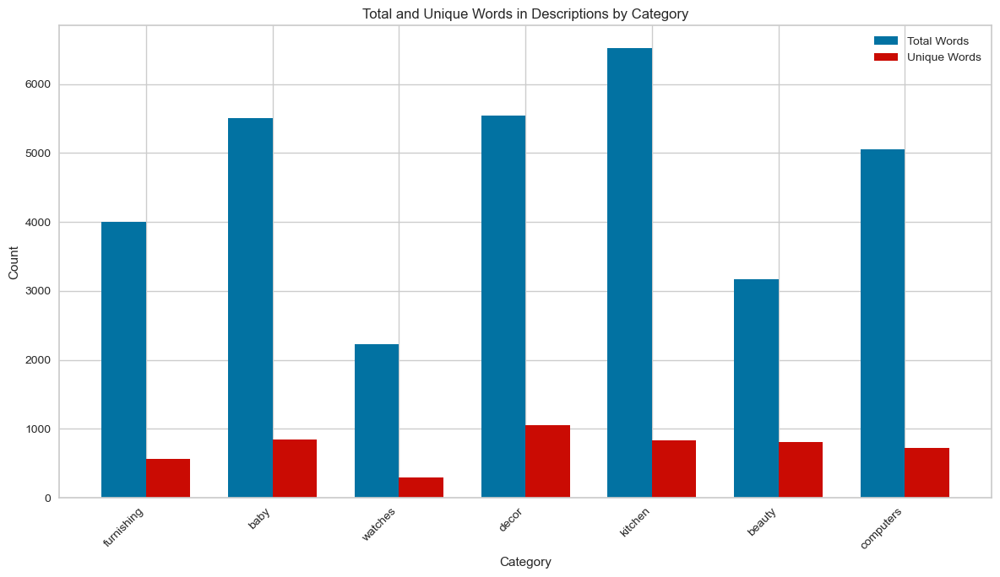

In [1832]:
total_words_dict = {}
unique_words_dict = {}
for category_key in descriptions:
    all_descriptions = ' '.join(descriptions[category_key])
    words = all_descriptions.split()
    
    total_words_dict[category_key] = len(words)
    unique_words_dict[category_key] = len(set(words))
    
categories = list(total_words_dict.keys())

bar_width = 0.35
index = np.arange(len(categories))

fig, ax = plt.subplots(figsize=(12, 7))
bar1 = ax.bar(index, total_words_dict.values(), bar_width, label='Total Words', color='b')
bar2 = ax.bar(index + bar_width, unique_words_dict.values(), bar_width, label='Unique Words', color='r')

ax.set_xlabel('Category')
ax.set_ylabel('Count')
ax.set_title('Total and Unique Words in Descriptions by Category')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(total_words_dict.keys(), rotation=45, ha='right')
ax.legend()

plt.tight_layout()
plt.show()








In [1833]:
for category_key in products_names:
    all_products_names = ' '.join(products_names[category_key])
    # Nous décomposons le texte en mots
    words = all_products_names.split()
    total_words = len(words)
    unique_words = len(set(words))
    
    print(f"\n# Category: {category_key}")
    print(f"Total words: {total_words}")
    print(f"Unique words: {unique_words}")
    print("----------------------")
    print()


# Category: furnishing
Total words: 631
Unique words: 116
----------------------


# Category: baby
Total words: 561
Unique words: 212
----------------------


# Category: watches
Total words: 404
Unique words: 73
----------------------


# Category: decor
Total words: 555
Unique words: 233
----------------------


# Category: kitchen
Total words: 501
Unique words: 202
----------------------


# Category: beauty
Total words: 538
Unique words: 284
----------------------


# Category: computers
Total words: 469
Unique words: 157
----------------------



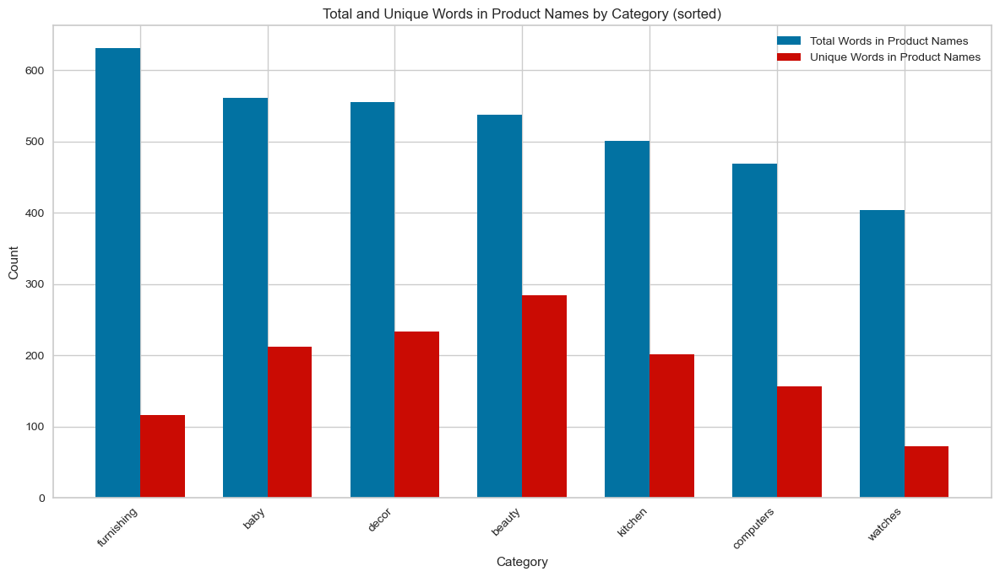

In [1834]:
# Dictionnaires pour stocker les résultats
total_words_dict_products = {}
unique_words_dict_products = {}

# Calcul du nombre de mots pour products_names
for category_key in products_names:
    all_product_names = ' '.join(products_names[category_key])
    words = all_product_names.split()
    total_words_dict_products[category_key] = len(words)
    unique_words_dict_products[category_key] = len(set(words))
# Nous obtenons des valeurs triées pour le nombre total et unique de mots
sorted_categories = sorted(total_words_dict_products, key=total_words_dict_products.get, reverse=True)
sorted_total_words_products = [total_words_dict_products[category] for category in sorted_categories]
sorted_unique_words_products = [unique_words_dict_products[category] for category in sorted_categories]

fig, ax = plt.subplots(figsize=(12, 7))
bar1 = ax.bar(index, sorted_total_words_products, bar_width, label='Total Words in Product Names', color='b')
bar2 = ax.bar(index + bar_width, sorted_unique_words_products, bar_width, label='Unique Words in Product Names', color='r')
ax.set_xlabel('Category')
ax.set_ylabel('Count')
ax.set_title('Total and Unique Words in Product Names by Category (sorted)')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(sorted_categories, rotation=45, ha='right')
ax.legend()

plt.tight_layout()
plt.show()


Analyse de l'ensemble des données (pour un apprentissage non supervisé)
Nous utiliserons à la fois le nom du produit et la description textuelle pour maximiser le caractère informatif de nos textes.

In [1835]:
N = 5000

def get_top_n_words(text, n=N):
    words = text.split()
    word_freq = Counter(words)
    
    top_n_words = [word[0] for word in word_freq.most_common(n)]
    return ' '.join(top_n_words)
df['combined'] = df['product_name'] + ' ' + df['brand'] + ' ' + df['description']

#df['top_words'] = df['combined'].apply(get_top_n_words)

print(df['combined'].head())


0    elegance polyester multicolor abstract eyelet ...
1    cotton bath towel  cotton bath towel bath towe...
2    cotton terry face towel  key cotton terry face...
3    royal fashion cotton printed king sized double...
4    cotton floral king sized double  key cotton fl...
Name: combined, dtype: object


/var/folders/0g/rj_1t2x52bz2m5m552wspnkc0000gn/T/ipykernel_67442/915437683.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['combined'] = df['product_name'] + ' ' + df['brand'] + ' ' + df['description']


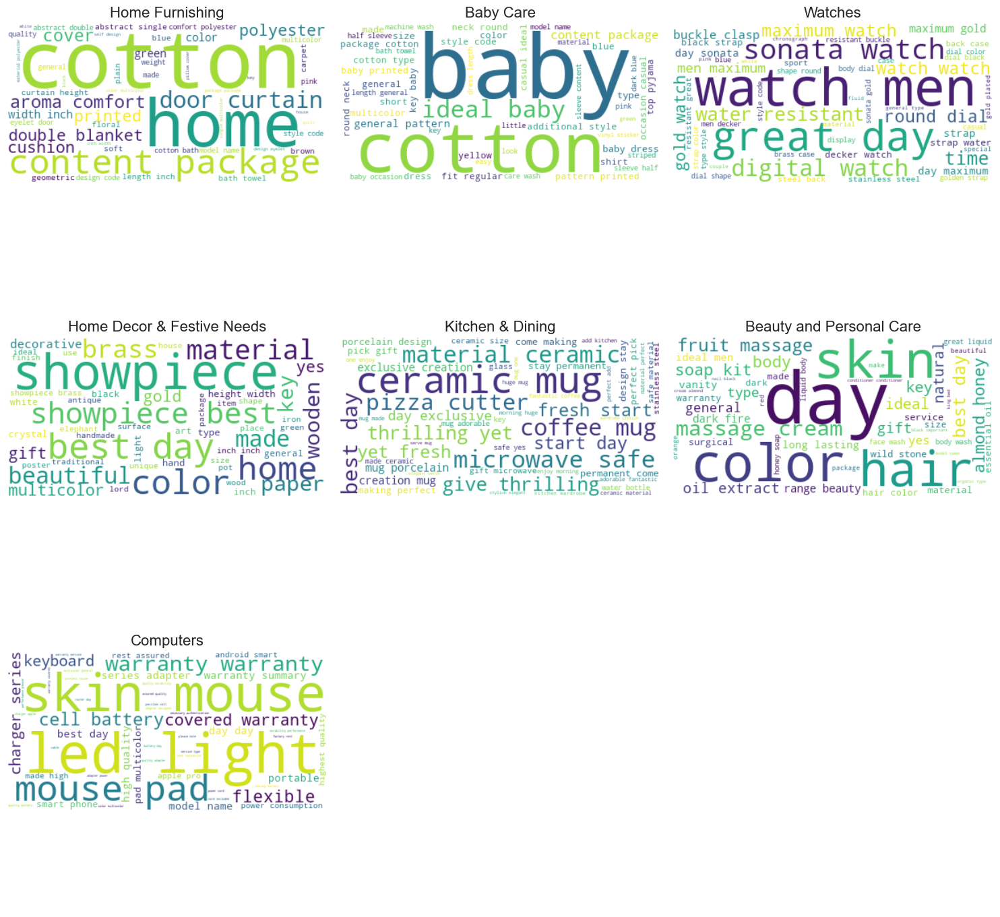

In [1836]:
categories = ['Home Furnishing', 'Baby Care', 'Watches', 'Home Decor & Festive Needs', 'Kitchen & Dining', 'Beauty and Personal Care', 'Computers']

fig, axs = plt.subplots(3, 3, figsize=(15, 15))

#WordCloud
for idx, category in enumerate(categories):
    subset = df[df['main_category'] == category]['combined']
    combined_text = ' '.join(subset)
    
    wordcloud = WordCloud(background_color='white', max_words=50).generate(combined_text)
    
    row, col = divmod(idx, 3)
    axs[row, col].imshow(wordcloud, interpolation='bilinear')
    axs[row, col].set_title(category, fontsize=16)
    axs[row, col].axis('off')

for idx in range(len(categories), 3*3):
    row, col = divmod(idx, 3)
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()


In [1837]:
#categories = ['Home Furnishing', 'Baby Care', 'Watches', 'Home Decor & Festive Needs', 'Kitchen & Dining', 'Beauty and Personal Care', 'Computers']

most_common_per_category = {}

for category in categories:
   
    subset = df[df['main_category'] == category]['combined']
    
    
    words = ' '.join(subset).split()
    
    most_common = Counter(words).most_common(100)
    most_common_per_category[category] = most_common


for category, common_words in most_common_per_category.items():
    print(f"\nCategory: {category}")
    for word, count in common_words:
        print(f"{word}: {count}")



Category: Home Furnishing
cotton: 134
cover: 107
single: 91
polyester: 82
design: 80
multicolor: 75
floral: 72
abstract: 68
color: 64
eyelet: 63
package: 63
curtain: 62
home: 62
double: 61
printed: 58
inch: 57
material: 56
blanket: 56
comfort: 55
door: 53
brown: 53
towel: 52
width: 49
general: 45
length: 44
bath: 44
code: 43
model: 42
content: 42
carpet: 40
aroma: 39
style: 38
cushion: 38
sheet: 37
type: 36
height: 33
key: 32
quality: 32
pattern: 31
green: 31
blue: 31
plain: 30
duvet: 29
table: 29
velvet: 29
linen: 28
soft: 27
made: 26
bed: 26
quilt: 26
care: 25
geometric: 25
wash: 24
hand: 24
sofa: 24
black: 24
white: 23
designed: 22
long: 22
room: 21
pink: 21
look: 20
name: 19
pillow: 19
weight: 19
self: 19
window: 18
high: 17
king: 17
machine: 17
washable: 17
additional: 17
house: 17
grey: 17
royal: 16
silk: 15
maroon: 15
intellect: 15
bazaar: 15
fashion: 14
gold: 14
coaster: 14
come: 14
kitchen: 14
use: 14
yellow: 13
back: 13
body: 12
flat: 12
prime: 12
shape: 12
day: 12
pure: 12


In [1838]:
category_words = {}
for category in categories:
    # Nous combinons tous les mots pour chaque catégorie
    all_words = ' '.join(df[df['main_category'] == category]['combined'].tolist())
    # Nous traduisons la liste de mots au set
    category_words[category] = set(all_words.split())

#Initialisation de l'ensemble avec des mots de la première catégorie
common_words_set = category_words[categories[0]]

# Prendre l'intersection avec toutes les autres catégories
for category in categories[1:]:
    common_words_set = common_words_set.intersection(category_words[category])

# Common_words_set contient désormais des mots qui apparaissent dans toutes les catégories

In [1839]:
print(len(common_words_set))


47


In [1840]:
N = 47  
print("Common words for all categories:")
print(", ".join(list(common_words_set)[:N]))


Common words for all categories:
quality, great, day, blue, vary, new, weight, well, green, way, one, size, touch, width, water, pink, red, material, like, suitable, yes, design, cover, multicolor, back, add, look, life, body, come, package, content, get, long, height, style, black, key, light, high, ideal, white, type, color, designed, may, general


In [1841]:
def remove_common_words(row):
    
    words_list = row['combined'].split()
    # Nous ne laissons que les mots qui ne sont pas présents dans common_words_set
    filtered_words = [word for word in words_list if word not in common_words_set]
    
    return ' '.join(filtered_words)
df.loc[:, 'combined'] = df.apply(remove_common_words, axis=1)




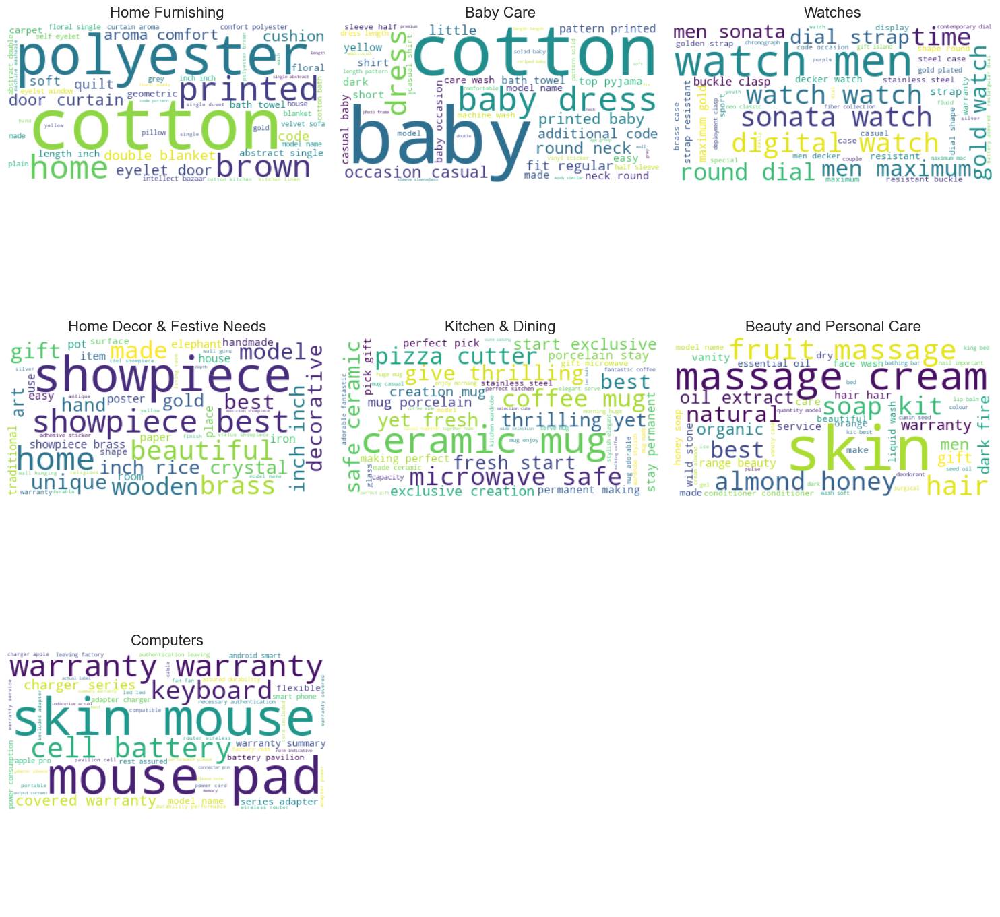

In [1842]:
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

#WordCloud
for idx, category in enumerate(categories):
    subset = df[df['main_category'] == category]['combined']
    combined_text = ' '.join(subset)
    
    wordcloud = WordCloud(background_color='white', max_words=50).generate(combined_text)
    
    row, col = divmod(idx, 3)
    axs[row, col].imshow(wordcloud, interpolation='bilinear')
    axs[row, col].set_title(category, fontsize=16)
    axs[row, col].axis('off')

for idx in range(len(categories), 3*3):
    row, col = divmod(idx, 3)
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()


In [1843]:
df.sample(10)

,uniq_id,image,product_name,brand,description,main_category,sub_category1,sub_category2,combined
503,c36ea960a14f164ee0f39ad6beb3796a,c36ea960a14f164ee0f39ad6beb3796a.jpg,sonata watch,,sonata watch sonata watch great day,Watches,Wrist Watches,Sonata Wrist Watches,sonata watch sonata watch sonata watch
585,a70ea60f971825b2eb57261029f317ec,a70ea60f971825b2eb57261029f317ec.jpg,watch men,,watch men watch men water resistant buckle cla...,Watches,Wrist Watches,Flippd Wrist Watches,watch men watch men watch men resistant buckle...
106,184ecf07ca4e2872eaf53d2344a1e783,184ecf07ca4e2872eaf53d2344a1e783.jpg,sun shade inflatable play pool,,sun shade inflatable play pool sun shade infla...,Baby Care,Furniture & Furnishings,Inflatable Products,sun shade inflatable play pool sun shade infla...
72,afc3ebd18df498dd87abb7ad7536b5c7,afc3ebd18df498dd87abb7ad7536b5c7.jpg,garnet traveller bottle,garnet,key garnet traveller bottle stylish quality ma...,Kitchen & Dining,Containers & Bottles,Bottles & Sippers,garnet traveller bottle garnet garnet travelle...
261,273982a65b9c7dabe56c8345552bfad7,273982a65b9c7dabe56c8345552bfad7.jpg,pristine hard,pristine,pristine hard aluminium pristine range gourmet...,Kitchen & Dining,Cookware,Pots & Pans,pristine hard pristine pristine hard aluminium...
542,3fa21f35257649e1513ca4ce22c6a68c,3fa21f35257649e1513ca4ce22c6a68c.jpg,maximum watch,,maximum watch maximum watch buckle clasp oval ...,Watches,Wrist Watches,Maxima Wrist Watches,maximum watch maximum watch maximum watch buck...
32,8b268c1e68f198ae2e934717d49f48e9,8b268c1e68f198ae2e934717d49f48e9.jpg,watch men,,watch men watch men great day,Watches,Wrist Watches,D'Signer Wrist Watches,watch men watch men watch men
88,04f9ff160a1561e3656350f4bd6b8c50,04f9ff160a1561e3656350f4bd6b8c50.jpg,craft trade oval wood coaster,craft trade,key craft trade oval wood coaster hand antique...,Home Furnishing,Kitchen & Dining Linen,Coasters,craft trade oval wood coaster craft trade craf...
938,9e07a3eeee6aa9e656106281cdd30d67,9e07a3eeee6aa9e656106281cdd30d67.jpg,lord elephant showpiece,,lord elephant showpiece lord elephant showpiec...,Home Decor & Festive Needs,Showpieces,eCraftIndia Showpieces,lord elephant showpiece lord elephant showpiec...
982,bdcc7e18ffed5390cd3107030992ffa6,bdcc7e18ffed5390cd3107030992ffa6.jpg,printed baby,,printed baby sleeve full sleeve content packag...,Baby Care,Infant Wear,Baby Boys' Clothes,printed baby printed baby sleeve full sleeve c...


In [1844]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   uniq_id        1050 non-null   object
 1   image          1050 non-null   object
 2   product_name   1050 non-null   object
 3   brand          1050 non-null   object
 4   description    1050 non-null   object
 5   main_category  1050 non-null   object
 6   sub_category1  1050 non-null   object
 7   sub_category2  1050 non-null   object
 8   combined       1050 non-null   object
dtypes: object(9)
memory usage: 74.0+ KB


In [1845]:
os.makedirs('data/cleaned/', exist_ok=True)


In [1848]:
df.to_pickle('data/cleaned/df_clean1.pkl')



# KMeans sur des données réduites

In [1520]:
def simple_tsne_plot(data, labels, ax=None):
    tsne = TSNE(n_components=2, random_state=0)
    tsne_results = tsne.fit_transform(data)

    df_subset = pd.DataFrame()
    df_subset['tsne-2d-one'] = tsne_results[:, 0]
    df_subset['tsne-2d-two'] = tsne_results[:, 1]
    df_subset['category'] = labels

    if ax is None:
        _, ax = plt.subplots(figsize=(10, 8))

    sns.scatterplot(
        x="tsne-2d-one", y="tsne-2d-two",
        hue="category",
        palette=sns.color_palette("hls", len(labels.unique())),
        data=df_subset,
        legend="full",
        alpha=0.6,
        ax=ax
    )

    ax.set_title('2D t-SNE representation colored by category')
    
    if ax is None:
        plt.show()


In [1716]:
def tsne_3d_plot(data, labels, ax=None):
    
    if ax is None:
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection='3d')
    
    tsne = TSNE(n_components=3, random_state=0)
    tsne_results = tsne.fit_transform(data)

    df_subset = pd.DataFrame()
    df_subset['tsne-3d-one'] = tsne_results[:, 0]
    df_subset['tsne-3d-two'] = tsne_results[:, 1]
    df_subset['tsne-3d-three'] = tsne_results[:, 2]
    df_subset['category'] = labels
    
    unique_labels = np.unique(labels)
    colors = sns.color_palette("hls", len(unique_labels))
    for i, category in enumerate(unique_labels):
#     colors = sns.color_palette("hls", len(labels.unique()))
#     for i, category in enumerate(labels.unique()):
        subset = df_subset[df_subset['category'] == category]
        ax.scatter(subset['tsne-3d-one'], subset['tsne-3d-two'], subset['tsne-3d-three'], s=60, color=colors[i], label=category)
    
    ax.set_title('3D t-SNE representation colored by category')
    ax.legend(loc='best')
    
    if ax is None:
        plt.show()


In [1531]:
def pca_explained_variance_plot(df):
    # Initialize and fit PCA
    pca = PCA()
    pca.fit(df)

    # Calculate explained variance for each component
    explained_variance = pca.explained_variance_ratio_

    # Plotting
    plt.figure(figsize=(10, 5))
    plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(1, len(explained_variance) + 1), explained_variance.cumsum(), where='mid', label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()



In [1541]:
def perform_pca(df, n_components):
    
    # Perform PCA on the given dataframe and return the principal components along with the explained variance.
    
    # PCA
    pca = PCA(n_components=n_components)
    principal_components = pca.fit_transform(df)

    # Create a new dataframe based on the principal components
    principal_df = pd.DataFrame(data=principal_components, columns=[f"Principal Component {i}" for i in range(1, n_components + 1)])

    # Calculate explained variance for each component
    explained_variance = pca.explained_variance_ratio_
    
    print(f"Explained Variance (first {n_components} components): {sum(explained_variance)*100:.2f}%")
    
    #return principal_df, sum(explained_variance)



In [1439]:
def kmeans_clustering(data, n_clusters=7):
    # Nous initialisons et formons KMeans
    model = KMeans(n_clusters=n_clusters, random_state=42)
    t0 = time.time()
    labels = model.fit_predict(data)  
    fit_time = time.time() - t0

    # Nous calculons les métriques
    inertia = model.inertia_
    silouhette_score_value = silhouette_score(data, labels)
    db_score = davies_bouldin_score(data, labels)
    
    # Nous affichons les métriques à l'écran
    print(f"Fit time: {fit_time:.3f}s")
    print(f"Inertia: {inertia:.0f}")
    print(f"Silhouette score: {silouhette_score_value:.3f}")
    print(f"Davies-Bouldin score: {db_score:.3f}")
    
    # Visualisation des silhouettes
    fig, ax = plt.subplots(figsize=(7, 6))
    visualizer = SilhouetteVisualizer(model, title=f'Silhouette plot for {n_clusters} clusters')
    visualizer.fit(data)
    visualizer.finalize()
    
    return labels


In [1440]:
def evaluate_clustering(true_labels, kmeans_labels):
   
    ari = adjusted_rand_score(true_labels, kmeans_labels)
    nmi = normalized_mutual_info_score(true_labels, kmeans_labels)

    print(f"Adjusted Rand Index: {ari}")
    print(f"Normalized Mutual Information: {nmi}")

    return ari, nmi


In [1522]:
def tsne_visualization(data, labels, principal_df, n_clusters=7, ax=None):
    if ax is None:
        _, ax = plt.subplots(figsize=(12, 8))    

    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(principal_df)
    
    # Додавання результатів t-SNE до датафрейму
    data['TSNE 1'] = tsne_results[:, 0]
    data['TSNE 2'] = tsne_results[:, 1]

    colors = ['red', 'blue', 'green', 'yellow', 'purple', 'orange', 'cyan']

    for i in range(n_clusters):
        ax.scatter(
            data[labels == i]['TSNE 1'], 
            data[labels == i]['TSNE 2'], 
            label=f'Cluster {i}', 
            color=colors[i]
        )

    ax.legend()
    ax.set_xlabel("TSNE Component 1")
    ax.set_ylabel("TSNE Component 2")
    ax.set_title("t-SNE visualization of KMeans Clustering")
    
    if ax is None:
        plt.show()


In [1502]:
def display_cluster_counts(kmeans_category):
    #Nous regroupons par étiquettes et catégories de cluster, après quoi nous comptons le nombre dans chaque groupe
    cluster_counts = df.groupby([kmeans_category, 'main_category']).size()
    # Nous parcourons les étiquettes uniques des clusters et imprimons les résultats
    for cluster in df[kmeans_category].unique():
        print(f"\n# Cluster {cluster}")
        print("___________")
        print(cluster_counts[cluster])
        print("-----------------------------")
        print("\n")

# Bag-of-Words

In [1700]:
bow_representation, bow_vectorizer = bag_of_words(df['combined'])
bow_df = pd.DataFrame(bow_representation.toarray(), columns=bow_vectorizer.get_feature_names_out())
print("Bag-of-Words Representation:")
print(bow_df.head())


Bag-of-Words Representation:
   able  abode  absorbency  absorbent  abstract  accent  access  accessory   
0     0      0           0          0         5       0       0          0  \
1     0      0           0          0         0       0       0          0   
2     0      0           1          0         0       0       0          0   
3     0      0           0          0         0       0       0          0   
4     0      0           0          0         0       0       0          0   

   accident  accidental  according  across  act  actual  adapter  adaptor   
0         0           0          0       0    0       0        0        0  \
1         0           0          0       0    0       0        0        0   
2         0           0          0       0    0       0        0        0   
3         0           0          0       0    0       0        0        0   
4         0           0          0       0    0       0        0        0   

   addition  additional  adhesive  adju

In [1701]:
bow_vectorizer.get_feature_names_out()


array(['able', 'abode', 'absorbency', ..., 'zero', 'zipper', 'zone'],
      dtype=object)

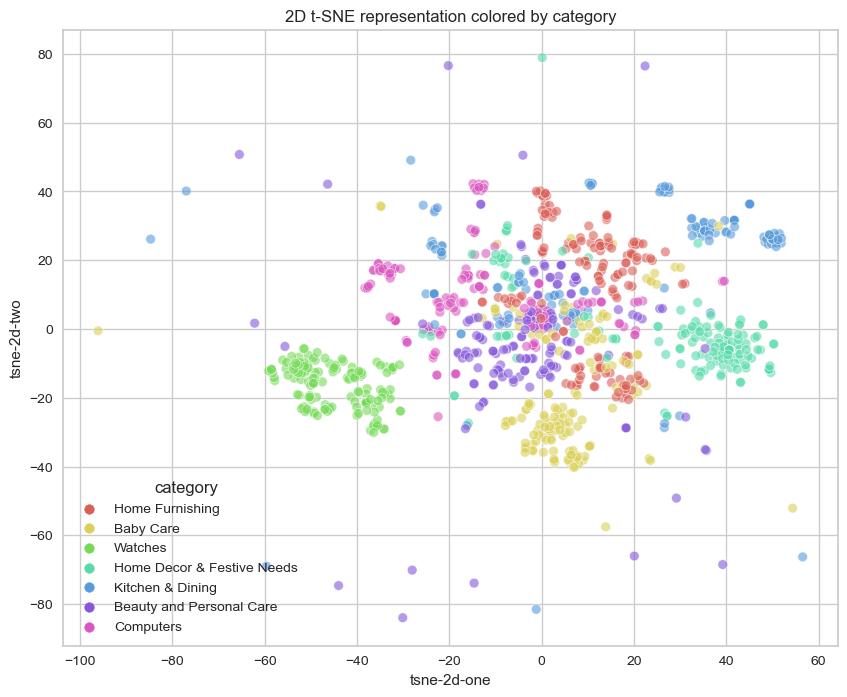

In [1702]:
simple_tsne_plot(bow_df, df['main_category'])

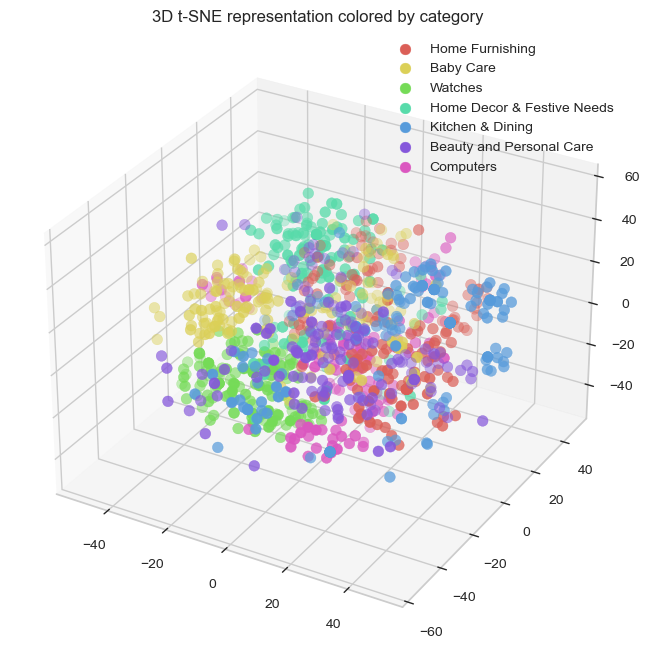

In [1703]:
tsne_3d_plot(bow_df, df['main_category'])

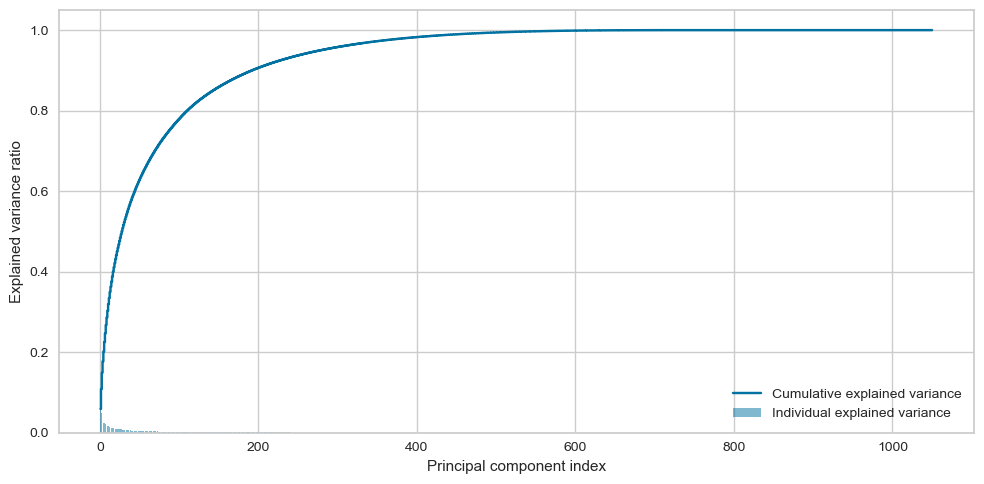

In [1704]:
pca_explained_variance_plot(bow_df)

In [1705]:
perform_pca(bow_df, 350)

Explained Variance (first 350 components): 97.21%


In [1706]:
principal_df_bow

,Principal Component 1,Principal Component 2,Principal Component 3,Principal Component 4,Principal Component 5,Principal Component 6,Principal Component 7,Principal Component 8,Principal Component 9,Principal Component 10,Principal Component 11,Principal Component 12,Principal Component 13,Principal Component 14,Principal Component 15,Principal Component 16,Principal Component 17,Principal Component 18,Principal Component 19,Principal Component 20,Principal Component 21,Principal Component 22,Principal Component 23,Principal Component 24,Principal Component 25,Principal Component 26,Principal Component 27,Principal Component 28,Principal Component 29,Principal Component 30,Principal Component 31,Principal Component 32,Principal Component 33,Principal Component 34,Principal Component 35,Principal Component 36,Principal Component 37,Principal Component 38,Principal Component 39,Principal Component 40,Principal Component 41,Principal Component 42,Principal Component 43,Principal Component 44,Principal Component 45,Principal Component 46,Principal Component 47,Principal Component 48,Principal Component 49,Principal Component 50,...,Principal Component 301,Principal Component 302,Principal Component 303,Principal Component 304,Principal Component 305,Principal Component 306,Principal Component 307,Principal Component 308,Principal Component 309,Principal Component 310,Principal Component 311,Principal Component 312,Principal Component 313,Principal Component 314,Principal Component 315,Principal Component 316,Principal Component 317,Principal Component 318,Principal Component 319,Principal Component 320,Principal Component 321,Principal Component 322,Principal Component 323,Principal Component 324,Principal Component 325,Principal Component 326,Principal Component 327,Principal Component 328,Principal Component 329,Principal Component 330,Principal Component 331,Principal Component 332,Principal Component 333,Principal Component 334,Principal Component 335,Principal Component 336,Principal Component 337,Principal Component 338,Principal Component 339,Principal Component 340,Principal Component 341,Principal Component 342,Principal Component 343,Principal Component 344,Principal Component 345,Principal Component 346,Principal Component 347,Principal Component 348,Principal Component 349,Principal Component 350
0,-0.164355,-0.140547,-0.045582,-2.304292,-1.806572,0.963341,-0.162125,0.318310,-0.452912,-0.356128,-3.001377,10.622429,4.923190,-3.925103,-1.621338,-0.964507,1.228521,-0.895756,-0.758914,-1.088813,0.192253,0.719718,0.435446,-1.247722,0.061627,-0.864446,1.104116,0.364927,0.352460,-1.261952,-0.312627,-0.938126,0.147667,1.089315,-0.866826,-0.650469,0.256997,0.668064,-1.171795,-1.057492,0.745374,-0.429365,0.757051,-0.577811,-2.060761,-0.098506,-1.254591,-3.886211,3.307994,0.046297,...,0.188147,0.116312,-0.279699,-0.045869,-0.083244,0.141829,-0.057410,0.041343,0.170883,0.096893,-0.348779,-0.181495,-0.074277,-0.257563,0.154471,-0.161877,-0.008612,-0.155906,0.065761,0.079709,-0.232861,-0.220875,-0.097338,0.069966,0.009100,-0.182552,0.248533,0.116182,-0.156049,0.039016,-0.121397,0.032585,0.109495,0.075797,0.013908,0.026514,0.071518,-0.068695,-0.279032,-0.061011,0.050143,-0.056249,0.051543,0.133511,-0.082966,-0.018066,-0.129945,-0.063229,-0.154383,0.175002
1,-1.010710,-0.641614,1.892449,-1.667930,0.096813,3.120607,-0.354675,-1.152434,-1.191748,-0.105918,-0.910205,-0.923401,-1.440893,-0.603412,-2.713036,1.307037,1.007077,3.029350,-4.929284,-0.578743,0.726928,-2.118033,-1.914662,1.677491,-0.796293,-1.784090,1.598638,0.070745,-0.801049,-0.207396,-0.288309,0.165351,-0.244087,-0.172203,1.026586,-0.013013,-0.112707,0.774228,0.496261,-0.161615,-0.291521,-1.244613,-0.012009,-0.225499,0.057198,0.033724,1.738525,0.763552,1.025563,0.790514,...,-0.121631,-0.040468,0.050963,0.129947,-0.182561,0.052243,0.019894,0.011156,0.114255,0.022898,-0.052738,0.209482,0.088633,-0.074803,0.191193,-0.028949,-0.074523,0.075031,0.262949,0.071182,-0.008787,0.049298

/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


Fit time: 0.081s
Inertia: 69394
Silhouette score: 0.075
Davies-Bouldin score: 1.553


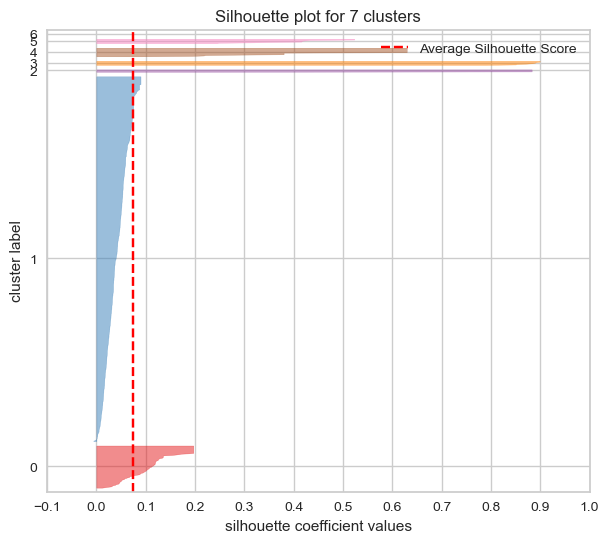

In [1707]:
labels_bow = kmeans_clustering(principal_df_bow, n_clusters=7)

In [1708]:
df = df.copy()
df['kmeans_category_bow'] = labels_bow
ari, nmi = evaluate_clustering(df['main_category'].tolist(), df['kmeans_category_bow'].tolist())

Adjusted Rand Index: 0.04761764968680273
Normalized Mutual Information: 0.24419275739201599


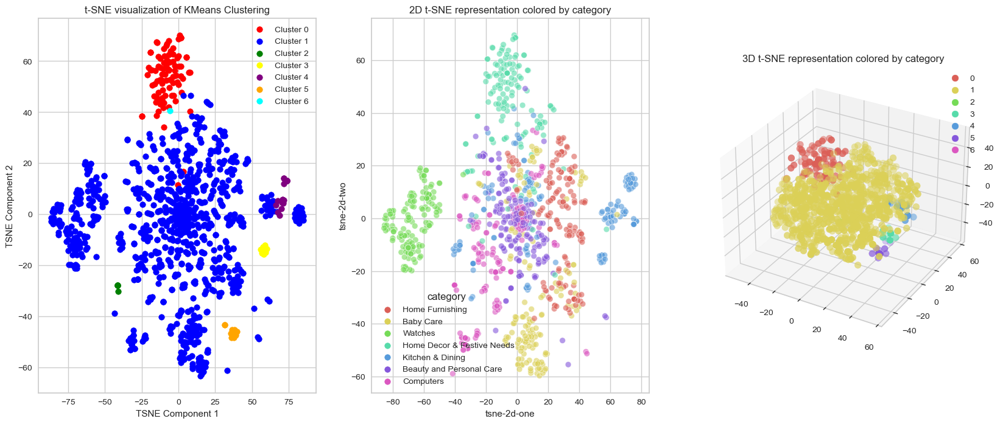

In [1717]:
fig = plt.figure(figsize=(20,8))

ax1 = fig.add_subplot(1, 3, 1)
tsne_visualization(df, labels_bow, principal_df_bow, ax=ax1)

ax2 = fig.add_subplot(1, 3, 2)
simple_tsne_plot(principal_df_bow, df['main_category'], ax=ax2)

# ax3 = fig.add_subplot(1, 3, 3, projection='3d')
# tsne_3d_plot(principal_df_bow, df['main_category'], ax=ax3)
ax3 = fig.add_subplot(1, 3, 3, projection='3d')
tsne_3d_plot(principal_df_bow, labels_bow, ax=ax3)  


plt.show()

In [1548]:
bow_df.shape

(1050, 1454)

On se retrouve avec une matrice très clairsemée de 1050 lignes (produits) x 1454 colonnes (mots).

In [1710]:
display_cluster_counts('kmeans_category_bow')


# Cluster 1
___________
main_category
Baby Care                     148
Beauty and Personal Care      147
Computers                     133
Home Decor & Festive Needs     48
Home Furnishing               150
Kitchen & Dining              117
Watches                       150
dtype: int64
-----------------------------



# Cluster 4
___________
main_category
Baby Care            1
Kitchen & Dining    21
dtype: int64
-----------------------------



# Cluster 6
___________
main_category
Kitchen & Dining    1
dtype: int64
-----------------------------



# Cluster 0
___________
main_category
Baby Care                       1
Beauty and Personal Care        1
Home Decor & Festive Needs    102
dtype: int64
-----------------------------



# Cluster 3
___________
main_category
Kitchen & Dining    11
dtype: int64
-----------------------------



# Cluster 2
___________
main_category
Computers    7
dtype: int64
-----------------------------



# Cluster 5
___________
main_category
Beauty and 

# TF-IDF

In [1455]:
tfidf_representation, tfidf_vectorizer = tf_idf(df['combined'])
tfidf_df = pd.DataFrame(tfidf_representation.toarray(), columns=tfidf_vectorizer.get_feature_names_out())
print("\nTF-IDF Representation:")
print(tfidf_df.head())


TF-IDF Representation:
   ability  able  abode  abroad  absolute  absorbency  absorbent  absorber   
0      0.0   0.0    0.0     0.0       0.0    0.000000        0.0       0.0  \
1      0.0   0.0    0.0     0.0       0.0    0.000000        0.0       0.0   
2      0.0   0.0    0.0     0.0       0.0    0.076492        0.0       0.0   
3      0.0   0.0    0.0     0.0       0.0    0.000000        0.0       0.0   
4      0.0   0.0    0.0     0.0       0.0    0.000000        0.0       0.0   

   absorbing  abstract  accent  access  accessory  accident  accidental   
0        0.0  0.222428     0.0     0.0        0.0       0.0         0.0  \
1        0.0  0.000000     0.0     0.0        0.0       0.0         0.0   
2        0.0  0.000000     0.0     0.0        0.0       0.0         0.0   
3        0.0  0.000000     0.0     0.0        0.0       0.0         0.0   
4        0.0  0.000000     0.0     0.0        0.0       0.0         0.0   

   accommodate  according  aching  acid  acne  across  a

In [1456]:
tfidf_df.shape

(1050, 2791)

Nous utiliserons la méthode tf-idf pour extraire des fonctionnalités de nos textes et obtenir une matrice que nous utiliserons dans le rendu t-SNE (donc avec des dimensions réduites).

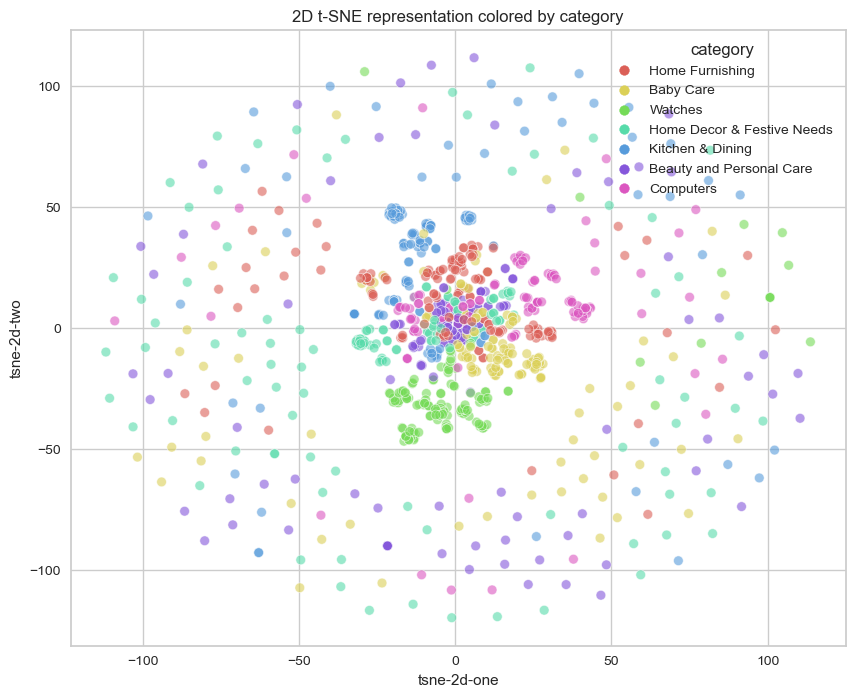

In [1457]:
simple_tsne_plot(tfidf_df, df['main_category'])


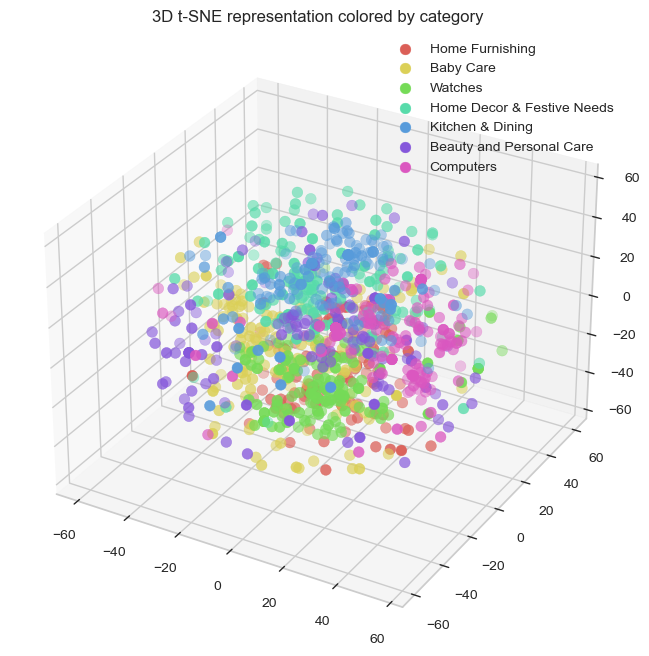

In [1458]:
tsne_3d_plot(tfidf_df, df['main_category'])


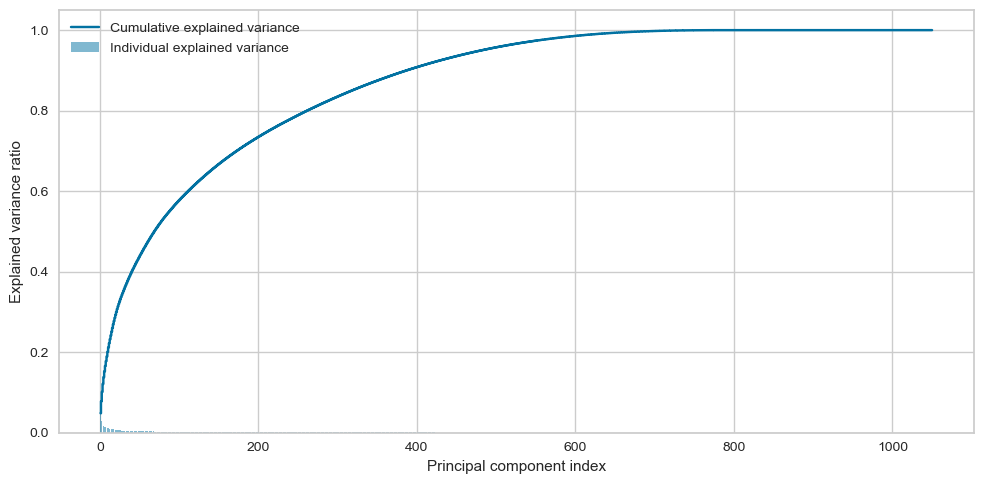

In [1533]:
pca_explained_variance_plot(tfidf_df)

In [1551]:
perform_pca(tfidf_df, 600)

Explained Variance (first 600 components): 98.53%


In [1552]:
principal_df_tfidf

,Principal Component 1,Principal Component 2,Principal Component 3,Principal Component 4,Principal Component 5,Principal Component 6,Principal Component 7,Principal Component 8,Principal Component 9,Principal Component 10,Principal Component 11,Principal Component 12,Principal Component 13,Principal Component 14,Principal Component 15,Principal Component 16,Principal Component 17,Principal Component 18,Principal Component 19,Principal Component 20,Principal Component 21,Principal Component 22,Principal Component 23,Principal Component 24,Principal Component 25,Principal Component 26,Principal Component 27,Principal Component 28,Principal Component 29,Principal Component 30,Principal Component 31,Principal Component 32,Principal Component 33,Principal Component 34,Principal Component 35,Principal Component 36,Principal Component 37,Principal Component 38,Principal Component 39,Principal Component 40,Principal Component 41,Principal Component 42,Principal Component 43,Principal Component 44,Principal Component 45,Principal Component 46,Principal Component 47,Principal Component 48,Principal Component 49,Principal Component 50,...,Principal Component 551,Principal Component 552,Principal Component 553,Principal Component 554,Principal Component 555,Principal Component 556,Principal Component 557,Principal Component 558,Principal Component 559,Principal Component 560,Principal Component 561,Principal Component 562,Principal Component 563,Principal Component 564,Principal Component 565,Principal Component 566,Principal Component 567,Principal Component 568,Principal Component 569,Principal Component 570,Principal Component 571,Principal Component 572,Principal Component 573,Principal Component 574,Principal Component 575,Principal Component 576,Principal Component 577,Principal Component 578,Principal Component 579,Principal Component 580,Principal Component 581,Principal Component 582,Principal Component 583,Principal Component 584,Principal Component 585,Principal Component 586,Principal Component 587,Principal Component 588,Principal Component 589,Principal Component 590,Principal Component 591,Principal Component 592,Principal Component 593,Principal Component 594,Principal Component 595,Principal Component 596,Principal Component 597,Principal Component 598,Principal Component 599,Principal Component 600
0,-0.085201,-0.044839,-0.025578,0.178147,0.063991,0.000909,-0.107373,-0.074833,-0.002694,0.037727,0.557374,0.023345,0.087987,-0.096929,-0.010070,-0.211348,0.104543,-0.149331,-0.045137,-0.015505,0.034319,0.023768,0.036660,-0.005135,0.023053,0.014799,0.029668,0.047629,0.033267,0.048104,0.039006,0.020164,0.084490,-0.095719,0.055506,0.013305,-0.077555,0.017183,-0.024751,-0.038753,-0.017690,-0.025644,-0.005196,-0.030129,0.019216,-0.007988,0.036305,-0.015696,-0.002752,0.001722,...,-0.056959,-0.020952,0.030253,0.010256,0.007050,-0.037810,0.019072,0.008069,-0.013621,-0.011716,0.012220,-0.020647,0.012800,0.017111,-0.017563,0.001052,-0.015200,0.005783,-0.042128,0.017460,-0.016935,-0.031473,-0.021758,-0.029960,-0.020573,-0.034217,-0.006702,0.006461,0.025886,-0.001263,-0.020289,-0.009685,-0.018826,-0.007578,-0.032121,0.018199,0.038962,-0.044979,-0.045301,0.015118,-0.002955,0.012921,-0.010780,0.036512,-0.021872,0.074633,-0.052718,-0.033950,-0.010202,0.032428
1,-0.072047,-0.117653,-0.165724,-0.075654,-0.056707,0.656320,0.463681,0.013428,0.024163,-0.009974,0.024535,0.013481,0.053527,0.012313,-0.020435,-0.078633,0.068703,-0.094909,-0.033204,0.150617,-0.071314,-0.000758,0.071525,-0.059001,-0.086421,-0.197822,0.098160,0.077912,-0.000416,-0.028883,0.055944,-0.029217,-0.022113,0.040603,-0.011598,-0.025718,0.056437,0.003168,0.002396,-0.009210,0.025264,-0.013613,-0.020703,-0.011599,-0.035905,0.016883,-0.010870,0.031492,-0.025348,0.001354,...,-0.000524,0.013197,-0.015092,0.000630,-0.008690,-0.008993,-0.001198,-0.001533,-0.004118,0.006335,0.010485,-0.013440,-0.010877,0.014395,-0.009228,0.020770,-0.006376,0.007485,-0.005664,-0.001615,0.019618,0.004110

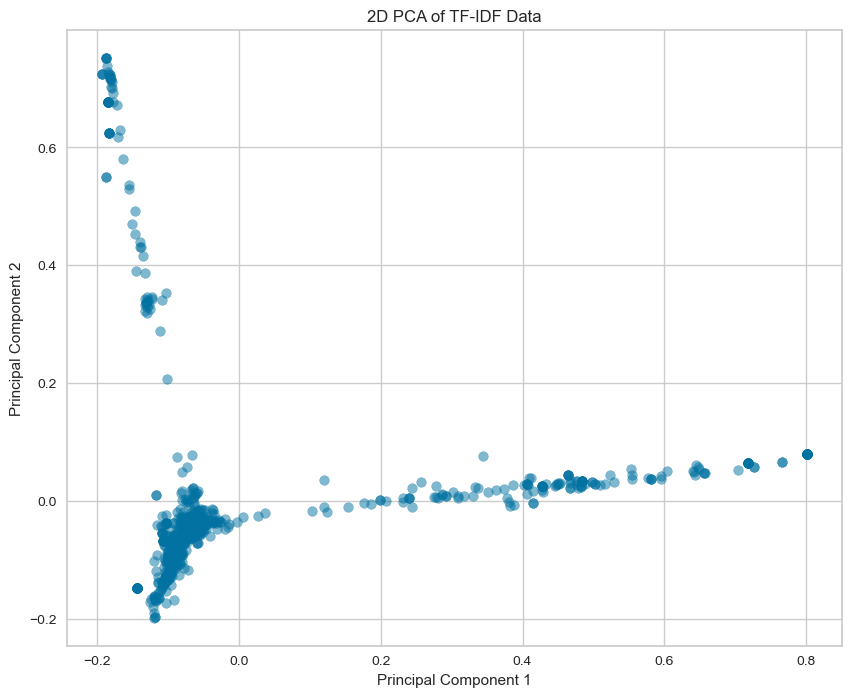

In [1553]:
plt.figure(figsize=(10, 8))
plt.scatter(principal_df_tfidf["Principal Component 1"], principal_df_tfidf["Principal Component 2"], alpha=0.5)
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.title("2D PCA of TF-IDF Data")
 
plt.show()



/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


Fit time: 0.124s
Inertia: 854
Silhouette score: 0.064
Davies-Bouldin score: 3.420


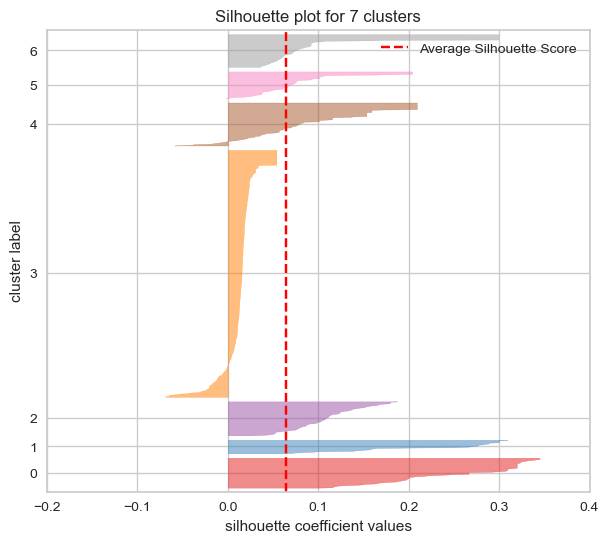

In [1554]:
labels_tfidf = kmeans_clustering(principal_df_tfidf, n_clusters=7)

Dans l'ensemble, ces indicateurs indiquent que notre modèle KMeans n'est peut-être pas le meilleur pour cet ensemble de données particulier. On peut essayer d'autres méthodes de clustering, modifier les méthodes de réduction de dimensionnalité ou ajuster les hyperparamètres de votre modèle actuel.

In [1555]:
df = df.copy()

df['kmeans_category_tfidf'] = labels_tfidf

ari, nmi = evaluate_clustering(df['main_category'].tolist(), df['kmeans_category_tfidf'].tolist())

Adjusted Rand Index: 0.1934770911423072
Normalized Mutual Information: 0.5068622066365257


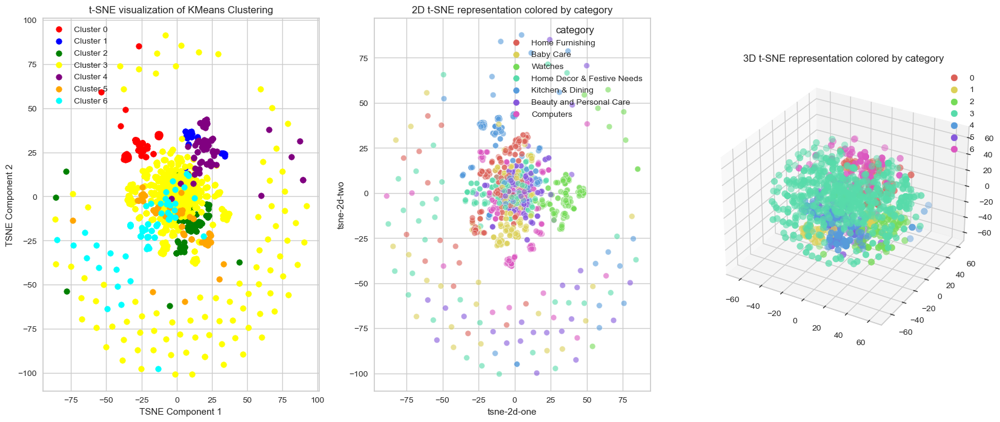

In [1719]:
fig = plt.figure(figsize=(20,8))

ax1 = fig.add_subplot(1, 3, 1)
tsne_visualization(df, labels_tfidf, principal_df_tfidf, ax=ax1)

ax2 = fig.add_subplot(1, 3, 2)
simple_tsne_plot(principal_df_tfidf, df['main_category'], ax=ax2)

ax3 = fig.add_subplot(1, 3, 3, projection='3d')
tsne_3d_plot(principal_df_tfidf, labels_tfidf, ax=ax3)

plt.show()


In [1559]:
display_cluster_counts('kmeans_category_tfidf')


# Cluster 3
___________
main_category
Baby Care                      48
Beauty and Personal Care      149
Computers                     150
Home Decor & Festive Needs     76
Home Furnishing               101
Kitchen & Dining               71
Watches                        10
dtype: int64
-----------------------------



# Cluster 5
___________
main_category
Baby Care          18
Home Furnishing    48
dtype: int64
-----------------------------



# Cluster 4
___________
main_category
Watches    106
dtype: int64
-----------------------------



# Cluster 2
___________
main_category
Baby Care          83
Home Furnishing     1
dtype: int64
-----------------------------



# Cluster 0
___________
main_category
Baby Care            1
Kitchen & Dining    73
dtype: int64
-----------------------------



# Cluster 6
___________
main_category
Beauty and Personal Care       1
Home Decor & Festive Needs    74
Kitchen & Dining               6
dtype: int64
-----------------------------



# Cluster

# USE (Universal Sentence Encoder)

In [1560]:
# Nous appliquons USE à chaque ligne de la colonne 'combined'
embedded_sentences = df['combined'].apply(use_embedding)

# Nous stockons la représentation vectorielle dans le DataFrame
#use_df = pd.DataFrame(embedded_sentences.tolist(), columns=[f"USE_{i}" for i in range(embedded_sentences.iloc[0].shape[1])])

use_array = [item[0] for item in embedded_sentences]
use_df = pd.DataFrame(use_array, columns=[f"USE_{i}" for i in range(use_array[0].shape[0])])

print("\nUniversal Sentence Encoder Representation:")
print(use_df.head())




Universal Sentence Encoder Representation:
                                              USE_0   
0  tf.Tensor(-0.054714132, shape=(), dtype=float32)  \
1  tf.Tensor(-0.014209846, shape=(), dtype=float32)   
2   tf.Tensor(-0.05418499, shape=(), dtype=float32)   
3  tf.Tensor(-0.055911593, shape=(), dtype=float32)   
4  tf.Tensor(-0.054030288, shape=(), dtype=float32)   

                                              USE_1   
0  tf.Tensor(-0.049381454, shape=(), dtype=float32)  \
1   tf.Tensor(0.023907378, shape=(), dtype=float32)   
2   tf.Tensor(0.024871513, shape=(), dtype=float32)   
3  tf.Tensor(-0.056374468, shape=(), dtype=float32)   
4   tf.Tensor(-0.05410431, shape=(), dtype=float32)   

                                              USE_2   
0   tf.Tensor(0.008858256, shape=(), dtype=float32)  \
1  tf.Tensor(-0.026434414, shape=(), dtype=float32)   
2  tf.Tensor(-0.039922446, shape=(), dtype=float32)   
3    tf.Tensor(0.04707284, shape=(), dtype=float32)   
4   tf.Tensor(0.032

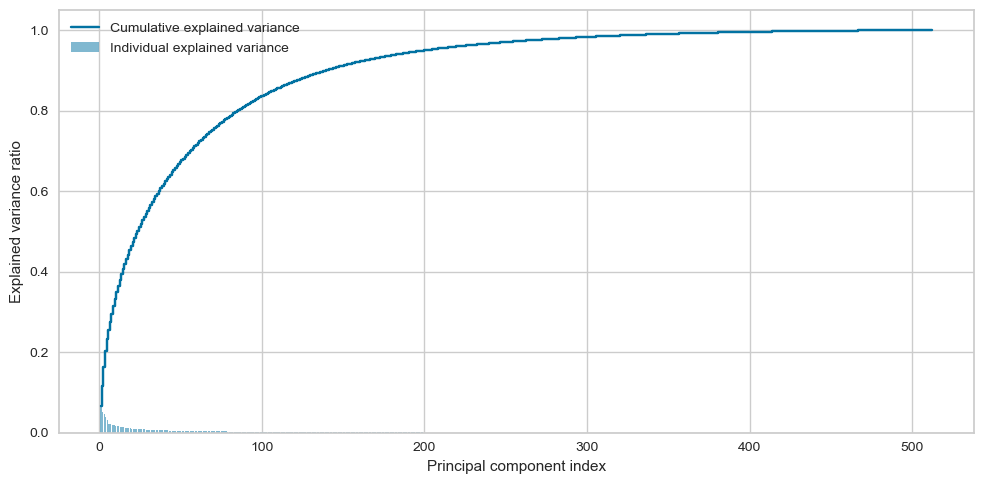

In [1561]:
pca_explained_variance_plot(use_df)

In [1566]:
perform_pca(use_df, 300)

Explained Variance (first 300 components): 98.28%


/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


Fit time: 0.092s
Inertia: 738
Silhouette score: 0.108
Davies-Bouldin score: 3.291


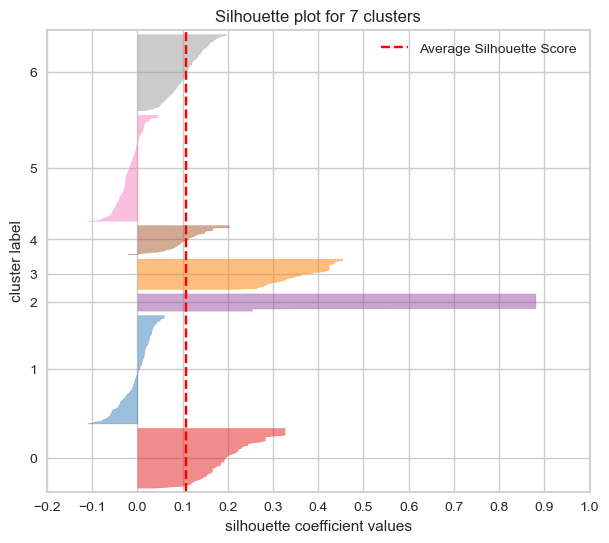

In [1563]:
labels_use = kmeans_clustering(principal_df_use, n_clusters=7)

In [1564]:
df['kmeans_category_use'] = labels_use
ari, nmi = evaluate_clustering(df['main_category'].tolist(), df['kmeans_category_use'].tolist())

Adjusted Rand Index: 0.3129676163725078
Normalized Mutual Information: 0.4738498279728325


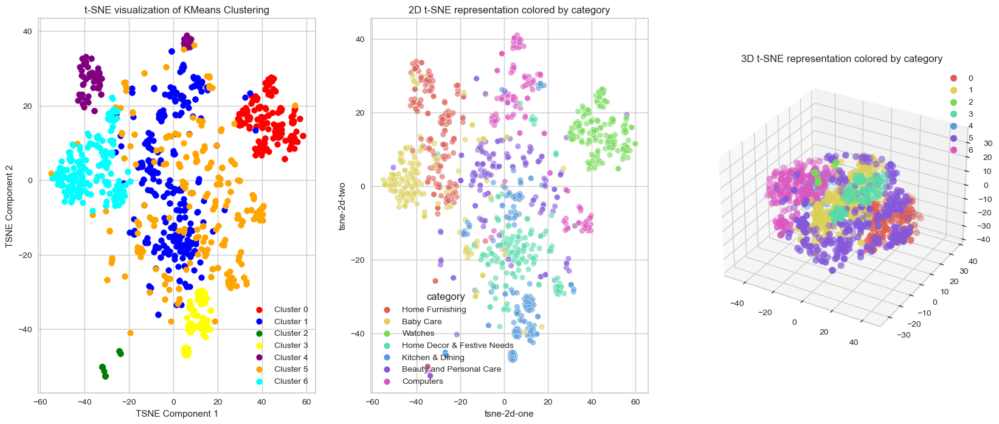

In [1720]:
fig = plt.figure(figsize=(20,8))

ax1 = fig.add_subplot(1, 3, 1)
tsne_visualization(df, labels_use, principal_df_use, ax=ax1)

ax2 = fig.add_subplot(1, 3, 2)
simple_tsne_plot(principal_df_use, df['main_category'], ax=ax2)

ax3 = fig.add_subplot(1, 3, 3, projection='3d')
tsne_3d_plot(principal_df_use, labels_use, ax=ax3)

plt.show()

In [1511]:
display_cluster_counts('kmeans_category_use')


# Cluster 6
___________
main_category
Baby Care                     107
Beauty and Personal Care        4
Home Decor & Festive Needs      1
Home Furnishing                75
dtype: int64
-----------------------------



# Cluster 0
___________
main_category
Watches    147
dtype: int64
-----------------------------



# Cluster 1
___________
main_category
Baby Care                     17
Beauty and Personal Care      53
Computers                     64
Home Decor & Festive Needs    83
Home Furnishing                8
Kitchen & Dining              38
Watches                        3
dtype: int64
-----------------------------



# Cluster 3
___________
main_category
Baby Care            1
Kitchen & Dining    74
dtype: int64
-----------------------------



# Cluster 5
___________
main_category
Baby Care                     20
Beauty and Personal Care      80
Computers                     47
Home Decor & Festive Needs    66
Home Furnishing               15
Kitchen & Dining              32

# BERT

In [1479]:
# Nous appliquons BERT à chaque ligne de la colonne « combinée »
embedded_sentences = df['combined'].apply(bert_embedding)

# On combine les vecteurs (prendre la moyenne) pour obtenir un vecteur par phrase


bert_array = [np.mean(item, axis=1).squeeze() for item in embedded_sentences]
bert_df = pd.DataFrame(bert_array)

print("\nBERT Representation:")
print(bert_df.head())



BERT Representation:
        0         1         2         3         4         5         6     
0 -0.100548 -0.058811  0.488872  0.015085  0.159717  0.143835  0.031892  \
1  0.111775 -0.093875  0.260308  0.266598 -0.027499  0.046607  0.058420   
2  0.031208 -0.056335  0.234802  0.122480  0.074681  0.188588 -0.033550   
3  0.088796 -0.103713  0.462404  0.075606 -0.003312  0.019137  0.044282   
4  0.144286 -0.164465  0.576499  0.128164  0.067908 -0.062060 -0.070824   

        7         8         9         10        11        12        13    
0 -0.079651 -0.135779 -0.257277  0.018432  0.018066  0.072655  0.173041  \
1 -0.302133 -0.175565 -0.208237  0.138224  0.002969 -0.009781  0.408124   
2 -0.099784 -0.151226 -0.244095 -0.050439 -0.039499  0.184147  0.210672   
3 -0.110452 -0.130985  0.021645 -0.100494 -0.010305  0.038457  0.171441   
4  0.002517 -0.030763 -0.181761 -0.046646 -0.103654  0.052404  0.257768   

        14        15        16        17        18        19        20    
0

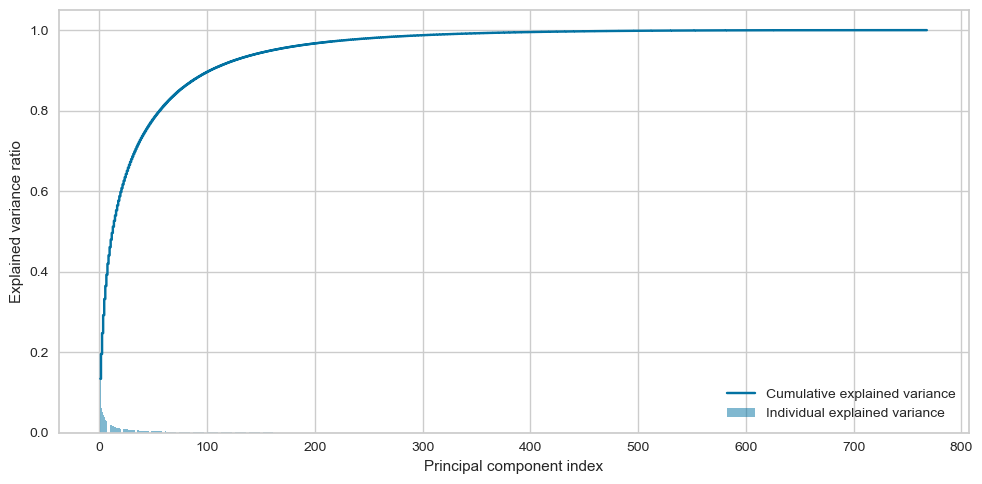

In [1567]:
pca_explained_variance_plot(bert_df)

In [1568]:
perform_pca(bert_df, 300)

Explained Variance (first 300 components): 98.73%


/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


Fit time: 0.122s
Inertia: 19854
Silhouette score: 0.092
Davies-Bouldin score: 2.483


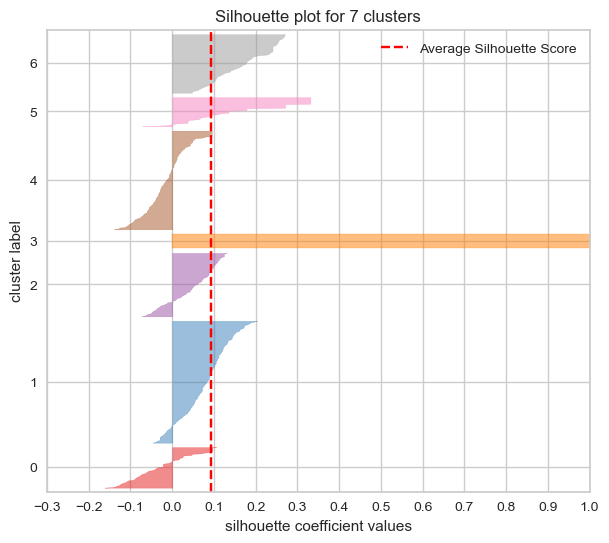

In [1569]:
# KMeans sur des données réduites
labels_bert = kmeans_clustering(principal_df_bert, n_clusters=7)

In [1570]:
df['kmeans_category_bert'] = labels_bert
ari, nmi = evaluate_clustering(df['main_category'].tolist(), df['kmeans_category_bert'].tolist())


Adjusted Rand Index: 0.17055205913492422
Normalized Mutual Information: 0.29258515622239906


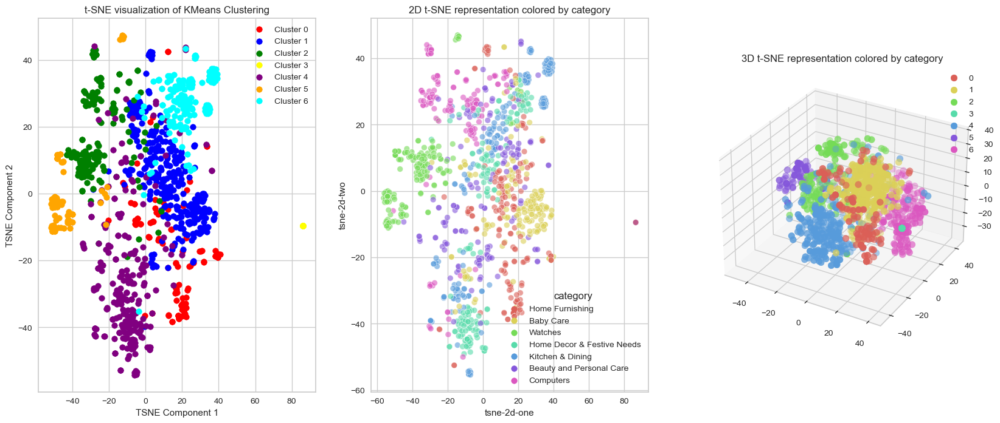

In [1721]:
fig = plt.figure(figsize=(20,8))

ax1 = fig.add_subplot(1, 3, 1)
tsne_visualization(df, labels_bert, principal_df_bert, ax=ax1)

ax2 = fig.add_subplot(1, 3, 2)
simple_tsne_plot(principal_df_bert, df['main_category'], ax=ax2)

ax3 = fig.add_subplot(1, 3, 3, projection='3d')
tsne_3d_plot(principal_df_bert, labels_bert, ax=ax3)

plt.show()

In [1572]:
display_cluster_counts('kmeans_category_bert')


# Cluster 1
___________
main_category
Baby Care                     105
Beauty and Personal Care       48
Computers                      31
Home Decor & Festive Needs     30
Home Furnishing                51
Kitchen & Dining               32
Watches                         2
dtype: int64
-----------------------------



# Cluster 5
___________
main_category
Beauty and Personal Care     2
Computers                    1
Watches                     69
dtype: int64
-----------------------------



# Cluster 6
___________
main_category
Baby Care                      7
Beauty and Personal Care       9
Computers                     16
Home Decor & Festive Needs    35
Home Furnishing               14
Kitchen & Dining              58
Watches                        5
dtype: int64
-----------------------------



# Cluster 2
___________
main_category
Baby Care                      3
Beauty and Personal Care       7
Computers                     60
Home Decor & Festive Needs     5
Home Furnishing

# Doc2Vec

In [1573]:
# Nous formons le modèle Doc2Vec
d2v_model = doc2vec_embedding(df['combined'])

# On continue la représentation vectorielle pour chaque document
doc_vectors = [d2v_model.dv[str(i)] for i in range(len(df['combined']))]

# Nous stockons la représentation vectorielle dans le DataFrame
doc2vec_df = pd.DataFrame(doc_vectors, columns=[f"D2V_{i}" for i in range(d2v_model.vector_size)])

print("\nDoc2Vec Representation:")
print(doc2vec_df.head())


Doc2Vec Representation:
      D2V_0     D2V_1     D2V_2     D2V_3     D2V_4     D2V_5     D2V_6   
0  0.249412  0.021126 -1.034192  0.272835  0.425736  1.288181 -0.011335  \
1 -0.248269 -0.439130 -1.144321 -1.138456  0.913568  0.257461 -0.436136   
2 -0.185453  0.602077  1.117174 -0.636189  0.417453  1.082409  0.270928   
3 -0.903399 -0.201273 -0.970941  0.159663 -0.777194 -1.266511  0.872513   
4 -0.374385  0.124883 -0.339655  0.182571 -0.866697 -0.682106  0.735051   

      D2V_7     D2V_8     D2V_9    D2V_10    D2V_11    D2V_12    D2V_13   
0  0.379542 -0.151936  0.487163  0.864310  0.451261 -0.251389 -0.342030  \
1  0.601524 -0.285708  0.978074  0.526136  0.475692 -0.145069 -0.607013   
2 -0.240034 -1.293422  0.155666 -0.487968  0.867903  0.039795  0.287300   
3 -0.837307 -0.681290 -0.541291 -0.914236  0.499954 -1.251088  0.112999   
4  0.109006 -0.328889 -0.346200 -0.819216 -0.756549 -0.589941  0.367478   

     D2V_14    D2V_15    D2V_16    D2V_17    D2V_18    D2V_19  
0  0.0641

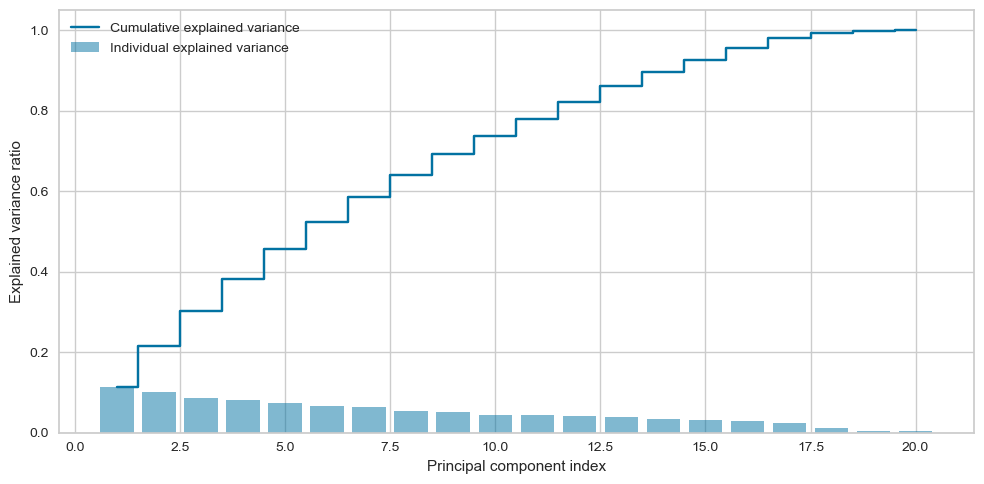

In [1574]:
pca_explained_variance_plot(doc2vec_df)

In [1729]:
perform_pca(doc2vec_df, 18)

Explained Variance (first 18 components): 99.23%


/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/innakonar/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


Fit time: 0.088s
Inertia: 7360
Silhouette score: 0.092
Davies-Bouldin score: 2.341


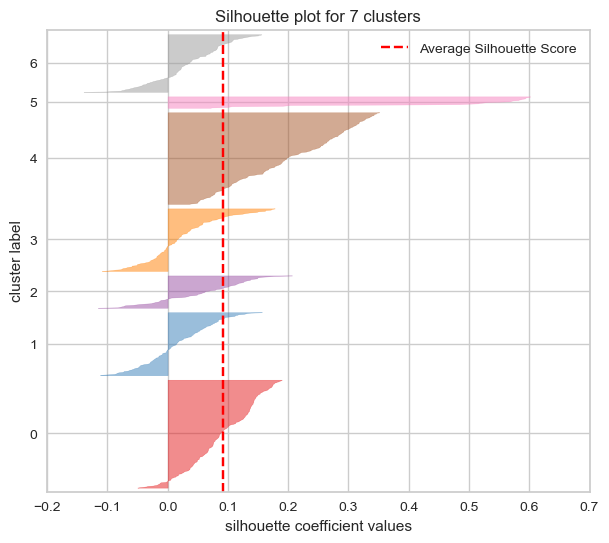

In [1730]:
labels_doc2vec = kmeans_clustering(principal_df_doc2vec, n_clusters=7)

In [1731]:
df['kmeans_category_doc2vec'] = labels_doc2vec
ari, nmi = evaluate_clustering(df['main_category'].tolist(), df['kmeans_category_doc2vec'].tolist())

Adjusted Rand Index: 0.10450703389318301
Normalized Mutual Information: 0.15546051055316618


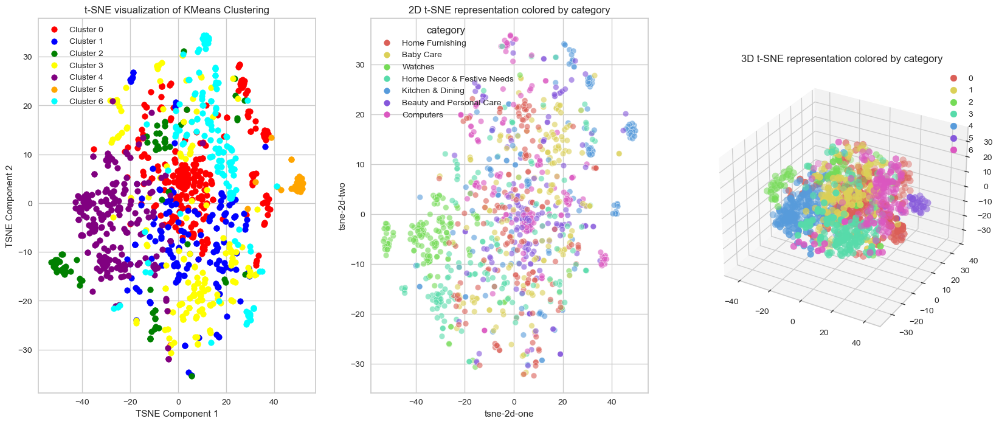

In [1732]:
fig = plt.figure(figsize=(20,8))

ax1 = fig.add_subplot(1, 3, 1)
tsne_visualization(df, labels_doc2vec, principal_df_doc2vec, ax=ax1)

ax2 = fig.add_subplot(1, 3, 2)
simple_tsne_plot(principal_df_doc2vec, df['main_category'], ax=ax2)

ax3 = fig.add_subplot(1, 3, 3, projection='3d')
tsne_3d_plot(principal_df_doc2vec,labels_doc2vec, ax=ax3)

plt.show()

In [1727]:
display_cluster_counts('kmeans_category_doc2vec')


# Cluster 0
___________
main_category
Baby Care                     23
Beauty and Personal Care      61
Computers                     41
Home Decor & Festive Needs    29
Home Furnishing               41
Kitchen & Dining              65
Watches                        5
dtype: int64
-----------------------------



# Cluster 4
___________
main_category
Baby Care                      10
Beauty and Personal Care        6
Computers                       9
Home Decor & Festive Needs     64
Home Furnishing                18
Kitchen & Dining               11
Watches                       107
dtype: int64
-----------------------------



# Cluster 2
___________
main_category
Baby Care                      3
Beauty and Personal Care      16
Computers                     19
Home Decor & Festive Needs     9
Home Furnishing                7
Kitchen & Dining               2
Watches                       24
dtype: int64
-----------------------------



# Cluster 6
___________
main_category
Baby Care